In [1]:
!pip install --upgrade pingouin

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import datetime
import random
import statistics
from math import pi
from matplotlib.gridspec import GridSpec
from dateutil.relativedelta import *
import matplotlib.dates as mdates
from matplotlib.dates import DateFormatter
import seaborn as sns
import scipy.stats
import pingouin as pg

In [3]:
# COMMON VARIABLES

alg_to_analyze = [
    'sentistrength_sentiment_analysis_score',
    'sentistrength_sentiment_analysis_polarity'
]

tpd_columns = ["text", "created_at", "id_user", "vader_sentiment_analysis_score", "vader_sentiment_analysis_polarity",
                         "oplexicon_sentiment_analysis_score", "oplexicon_sentiment_analysis_polarity",
                         "sentistrength_sentiment_analysis_score", "sentistrength_sentiment_analysis_polarity",
                         "sentilexpt_sentiment_analysis_score", "sentilexpt_sentiment_analysis_polarity",
                         "final_score", "final_polarity"]

clean_df_columns = [
    'text',
    'final_score',
    'final_polarity',
    'oplexicon_sentiment_analysis_score',
    'oplexicon_sentiment_analysis_polarity',
    'vader_sentiment_analysis_score',
    'vader_sentiment_analysis_polarity',
    'sentilexpt_sentiment_analysis_score',
    'sentilexpt_sentiment_analysis_polarity'
]

In [4]:
!python3 '/Users/leosilva/development/thesis/workspacePyCharm/TwitterDataMining/main_generate_json_files.py'

Starting script...
Removing existing file...
Ending script...


In [5]:
data = pd.read_json(r'/Users/leosilva/development/thesis/workspacePyCharm/TwitterDataMining/alldata.json')
data.head()

,26,27,28,29,30,31,32,33,34,35,36,37
id_str_twitter,23781146,15148309,927028057763995648,77648005,3429765093,10794662,1034514325644431361,529445600,12050562,62314491,18289937,172880784
name,Fe Rebelatto,Sommelier de Airbnb,✪ Felippe,Conference Distinguished Specialist,Paula Santana,Maharaja of the Legacies,Jessica,"var nickname = ""Riquettinha"";",Roberta Arcoverde,Gabriela,Thamara Andrade,felipe.ts ⚡
screen_name,rebelatto,Guilh_rm_,FelippeRegazio,NannoKa,psanrosa13,rponte,dev_jessi,Riquettinha,rla4,Gabrielathalita,thamyk,felipefialho_
location,"Rio de Janeiro, Brasil",somewhere in Brazil,,Ctba-PR Brasil,Brasil,"Ceará, Brazil",São Paulo - Brasil,"Belo Horizonte, Brasil","Sao Paulo, Brazil",Belo Horizonte,"Belo Horizonte, Brazil.",Dark Side of the Moon
url,None,https://t.co/gX4oRZWHg3,https://t.co/KkaPlVH4Wu,https://t.co/hDni4Fh2Ng,https://t.co/YJQuDtv2YW,https://t.co/3yZ94QNQvs,https://t.co/MtUeSEBICu,https://t.co/QU71LJgSuD,None,https://t.co/AmkOKWlftK,https://t.co/JWBzdmQOcV,https://t.co/yPuEuh1bn9


In [6]:
def clean_df(df):
    for c in clean_df_columns:
        del df[c]

In [7]:
def create_tweets_pd(data, id_user):

    tweets_pd = pd.DataFrame(data[id_user]['tweets'])
    del tweets_pd[0]
    del tweets_pd[1]
    del tweets_pd[4]
    del tweets_pd[5]
    del tweets_pd[6]
    del tweets_pd[18]
    
    tweets_pd.columns = ["text", "created_at", "id_user", "vader_sentiment_analysis_score", "vader_sentiment_analysis_polarity",
                         "oplexicon_sentiment_analysis_score", "oplexicon_sentiment_analysis_polarity",
                         "sentistrength_sentiment_analysis_score", "sentistrength_sentiment_analysis_polarity",
                         "sentilexpt_sentiment_analysis_score", "sentilexpt_sentiment_analysis_polarity",
                         "final_score", "final_polarity"]
 
    return tweets_pd

In [8]:
def create_line_plot(df_result, id_user):
    df_result["created_at"] = pd.to_datetime(df_result["created_at"])
    df_result['date_minus_time'] = df_result["created_at"].apply( lambda df_result : datetime.datetime(year=df_result.year, month=df_result.month, day=df_result.day))
    df_result.set_index(df_result["date_minus_time"],inplace=True)

    new_df = pd.DataFrame(df_result[alg_to_analyze[0]].resample('W').mean())

    new_df['week'] = range(1, len(new_df.index) + 1)

    x = new_df["week"]
    y = new_df[alg_to_analyze[0]]

    tickvalues = range(0, int(len(x)), 2)

    if len(tickvalues) > len(x[1::2]):
        tickvalues = range(0, int(len(x)) - (len(tickvalues) - len(x[1::2])), 2)

    fig = plt.figure(figsize=(16,6))

    plt.xticks(ticks = tickvalues ,labels = x[1::2], rotation = 'vertical')

    plt.title("Tweets Sentistrength polarity per week - Participant {}".format(id_user))
    plt.ylabel("Polarity")
    plt.xlabel("Weeks")

    plt.axhline(y.mean(), color='k', linestyle='dashed', linewidth=1)
    min_ylim, max_ylim = plt.ylim()
    plt.text(y.mean()*0.05, max_ylim*0.12, 'Mean: {:.2f}'.format(y.mean()))

    plt.plot(x,y)

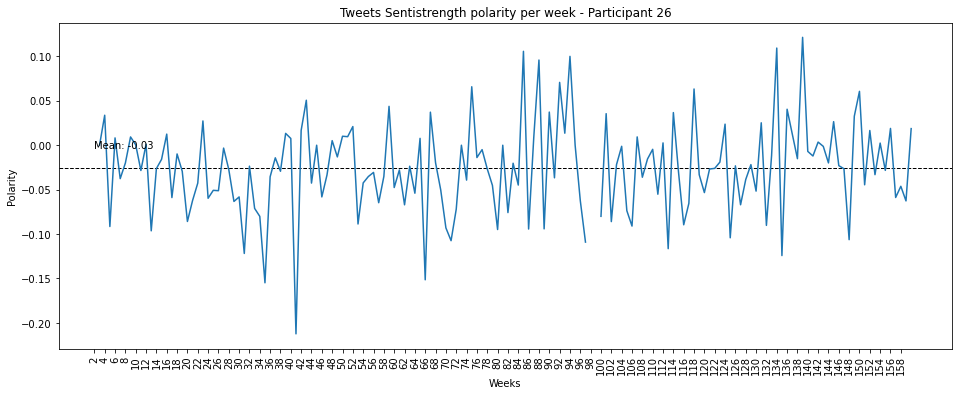

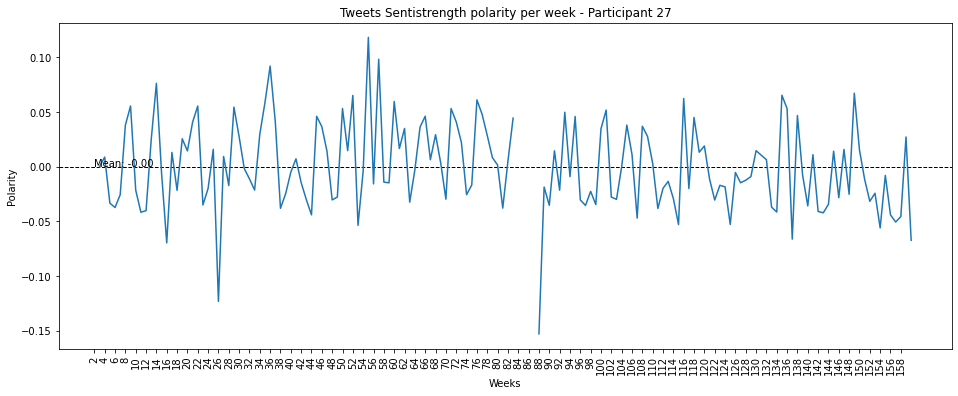

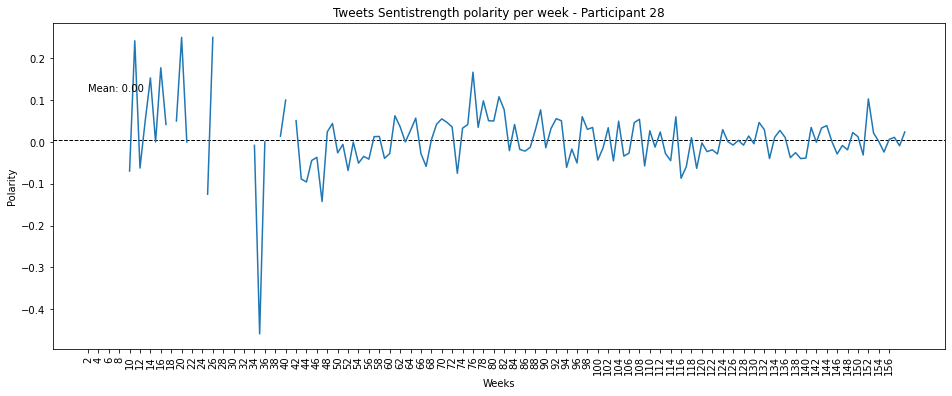

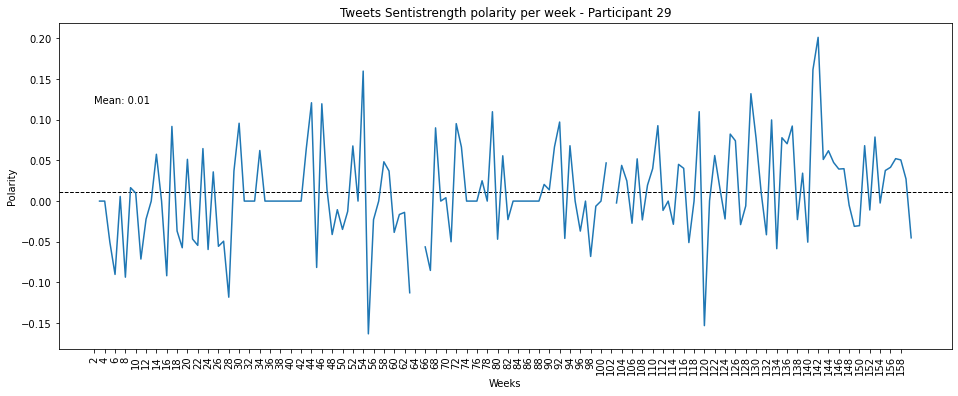

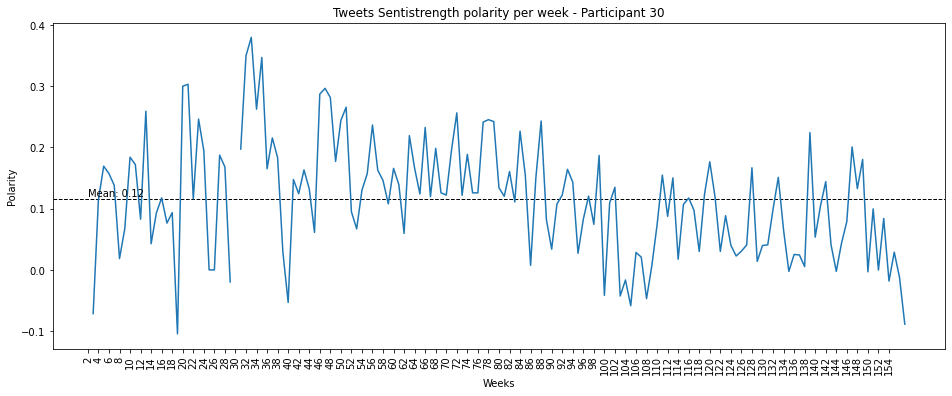

...

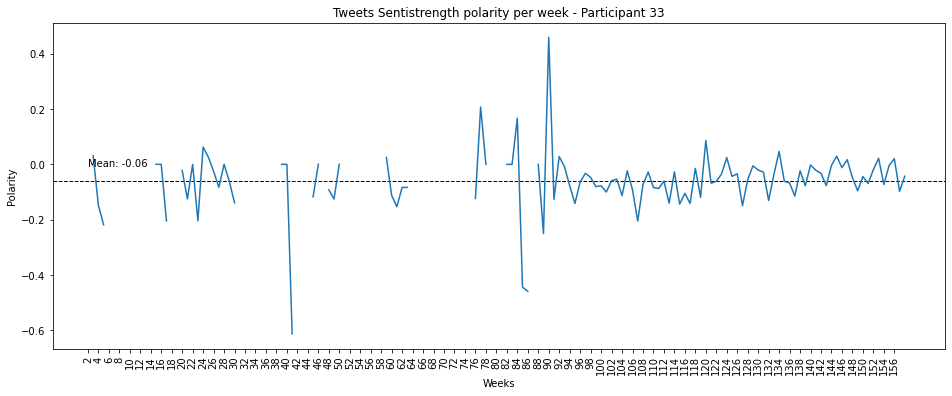

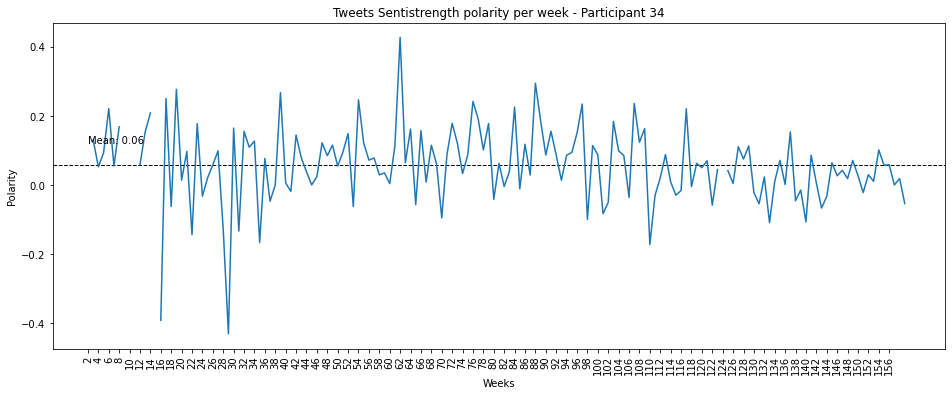

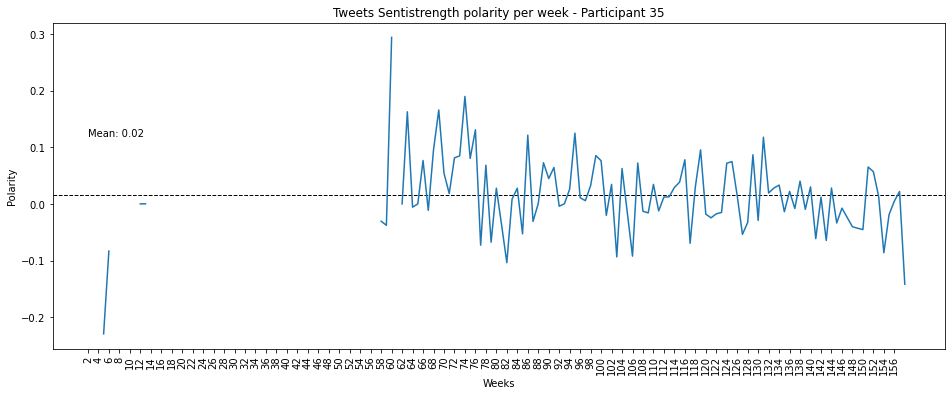

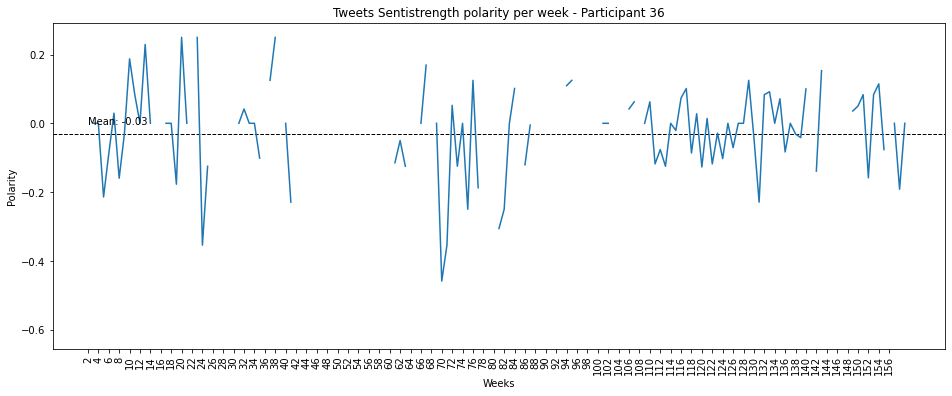

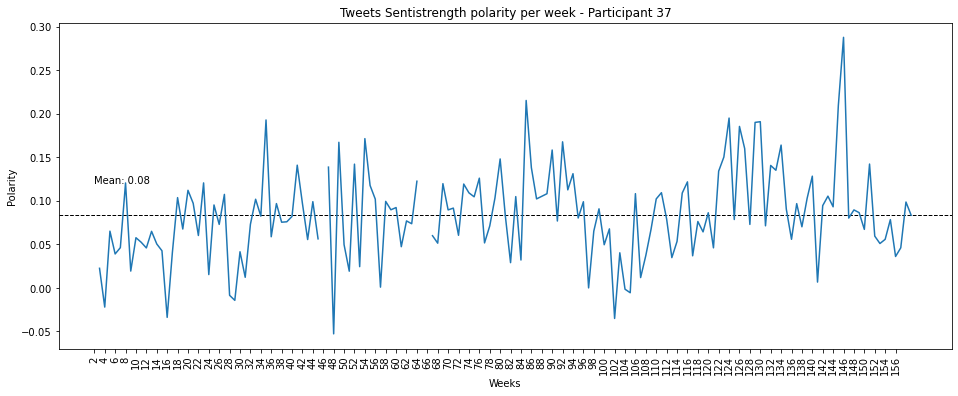

In [9]:
for c in data:
    id_user = c
    tweets_pd = create_tweets_pd(data, id_user)
    
    create_line_plot(tweets_pd, id_user)

In [10]:
# DATA CONSIDERING THE NEUTRAL POLARITY

df_dict = {'id_user' : [],
            'pos' : [],
            'neu' : [],
            'neg' : [],
            'por_pos' : [],
            'por_neu' : [],
            'por_neg' : [],
            'mean' : []
          }

for c in data:
    id_user = c
    print('id_user: {}'.format(id_user))
    print('lexicon: Sentistrength')
    tweets_pd = create_tweets_pd(data, id_user)
    vader_df = tweets_pd[['id_user', alg_to_analyze[0], alg_to_analyze[1]]].copy()
    print('mean: {}'.format(vader_df[alg_to_analyze[0]].mean()))
    qtd_pos = vader_df.query(alg_to_analyze[1] + ' == "pos"')['id_user'].count()
    qtd_neu = vader_df.query(alg_to_analyze[1] + ' == "neu"')['id_user'].count()
    qtd_neg = vader_df.query(alg_to_analyze[1] + ' == "neg"')['id_user'].count()
    qtd_total = vader_df[alg_to_analyze[1]].count()
    print('pos: {}'.format(qtd_pos))
    print('neu: {}'.format(qtd_neu))
    print('neg: {}'.format(qtd_neg))
    print('% pos: {}'.format((qtd_pos / qtd_total) * 100))
    print('% neu: {}'.format((qtd_neu / qtd_total) * 100))
    print('% neg: {}'.format((qtd_neg / qtd_total) * 100))
    print('')
    df_dict['id_user'].append(id_user)
    df_dict['pos'].append(qtd_pos)
    df_dict['neu'].append(qtd_neu)
    df_dict['neg'].append(qtd_neg)
    df_dict['por_pos'].append((qtd_pos / qtd_total) * 100)
    df_dict['por_neu'].append((qtd_neu / qtd_total) * 100)
    df_dict['por_neg'].append((qtd_neg / qtd_total) * 100)
    df_dict['mean'].append(vader_df[alg_to_analyze[0]].mean())

df_chart = pd.DataFrame(df_dict)
df_chart
    

id_user: 26
lexicon: Sentistrength
mean: -0.02879810805715419
pos: 1008
neu: 2754
neg: 1277
% pos: 20.003969041476484
% neu: 54.653701131176824
% neg: 25.342329827346692

id_user: 27
lexicon: Sentistrength
mean: -0.005643520281380486
pos: 962
neu: 2682
neg: 905
% pos: 21.14750494614201
% neu: 58.958012750054955
% neg: 19.894482303803034

id_user: 28
lexicon: Sentistrength
mean: 0.001440869155570535
pos: 1519
neu: 2992
neg: 1422
% pos: 25.60256194168212
% neu: 50.429799426934096
% neg: 23.967638631383785

id_user: 29
lexicon: Sentistrength
mean: 0.017986535939086244
pos: 973
neu: 1670
neg: 706
% pos: 29.053448790683785
% neu: 49.86563153180054
% neg: 21.080919677515677

id_user: 30
lexicon: Sentistrength
mean: 0.11494862603404794
pos: 1517
neu: 1219
neg: 436
% pos: 47.82471626733922
% neu: 38.43001261034048
% neg: 13.745271122320302

id_user: 31
lexicon: Sentistrength
mean: 0.0706241041094068
pos: 2805
neu: 1986
neg: 1205
% pos: 46.78118745830553
% neu: 33.12208138759173
% neg: 20.09673

,id_user,pos,neu,neg,por_pos,por_neu,por_neg,mean
0,26,1008,2754,1277,20.003969,54.653701,25.342330,-0.028798
1,27,962,2682,905,21.147505,58.958013,19.894482,-0.005644
2,28,1519,2992,1422,25.602562,50.429799,23.967639,0.001441
3,29,973,1670,706,29.053449,49.865632,21.080920,0.017987
4,30,1517,1219,436,47.824716,38.430013,13.745271,0.114949
5,31,2805,1986,1205,46.781187,33.122081,20.096731,0.070624
6,32,3604,3863,1707,39.284936,42.108132,18.606933,0.060513
7,33,505,1068,758,21.664522,45.817246,32.518233,-0.051833
8,34,575,656,314,37.216828,42.459547,20.323625,0.050776
9,35,689,1378,528,26.551060,53.102119,20.346821,0.022095


In [11]:
# DATA WITHOUT THE NEUTRAL POLARITY

df_dict = {'id_user' : [],
            'pos' : [],
            'neu' : [],
            'neg' : [],
            'por_pos' : [],
            'por_neu' : [],
            'por_neg' : [],
            'mean_all' : [],
            'mean_posneg' : []
          }

for c in data:
    id_user = c
    print('id_user: {}'.format(id_user))
    print('lexicon: Sentistrength')
    tweets_pd = create_tweets_pd(data, id_user)
    vader_df = tweets_pd[['id_user', alg_to_analyze[0], alg_to_analyze[1]]].copy()
    final_score = vader_df.query(alg_to_analyze[1] + ' == "pos"')[alg_to_analyze[0]].tolist()
    final_score.extend(vader_df.query(alg_to_analyze[1] + ' == "neg"')[alg_to_analyze[0]].tolist())
    print(len(final_score))
    print(statistics.mean(final_score))
    print('mean: {}'.format(vader_df[alg_to_analyze[0]].mean()))
    qtd_pos = vader_df.query(alg_to_analyze[1] + ' == "pos"')['id_user'].count()
    qtd_neu = vader_df.query(alg_to_analyze[1] + ' == "neu"')['id_user'].count()
    qtd_neg = vader_df.query(alg_to_analyze[1] + ' == "neg"')['id_user'].count()
    qtd_total = vader_df[alg_to_analyze[1]].count()
    print('pos: {}'.format(qtd_pos))
    print('neu: {}'.format(qtd_neu))
    print('neg: {}'.format(qtd_neg))
    print('% pos: {}'.format((qtd_pos / qtd_total) * 100))
    print('% neu: {}'.format((qtd_neu / qtd_total) * 100))
    print('% neg: {}'.format((qtd_neg / qtd_total) * 100))
    print('')
    df_dict['id_user'].append(id_user)
    df_dict['pos'].append(qtd_pos)
    df_dict['neu'].append(qtd_neu)
    df_dict['neg'].append(qtd_neg)
    df_dict['por_pos'].append((qtd_pos / qtd_total) * 100)
    df_dict['por_neu'].append((qtd_neu / qtd_total) * 100)
    df_dict['por_neg'].append((qtd_neg / qtd_total) * 100)
    df_dict['mean_all'].append(vader_df[alg_to_analyze[0]].mean())
    df_dict['mean_posneg'].append(statistics.mean(final_score))

df_chart = pd.DataFrame(df_dict)
df_chart
    

id_user: 26
lexicon: Sentistrength
2285
-0.0635070750547046
mean: -0.02879810805715419
pos: 1008
neu: 2754
neg: 1277
% pos: 20.003969041476484
% neu: 54.653701131176824
% neg: 25.342329827346692

id_user: 27
lexicon: Sentistrength
1867
-0.013750601906802357
mean: -0.005643520281380486
pos: 962
neu: 2682
neg: 905
% pos: 21.14750494614201
% neu: 58.958012750054955
% neg: 19.894482303803034

id_user: 28
lexicon: Sentistrength
2941
0.0029067244814688876
mean: 0.001440869155570535
pos: 1519
neu: 2992
neg: 1422
% pos: 25.60256194168212
% neu: 50.429799426934096
% neg: 23.967638631383785

id_user: 29
lexicon: Sentistrength
1679
0.035876658046456227
mean: 0.017986535939086244
pos: 973
neu: 1670
neg: 706
% pos: 29.053448790683785
% neu: 49.86563153180054
% neg: 21.080919677515677

id_user: 30
lexicon: Sentistrength
1953
0.18669587392729134
mean: 0.11494862603404794
pos: 1517
neu: 1219
neg: 436
% pos: 47.82471626733922
% neu: 38.43001261034048
% neg: 13.745271122320302

id_user: 31
lexicon: Sent

,id_user,pos,neu,neg,por_pos,por_neu,por_neg,mean_all,mean_posneg
0,26,1008,2754,1277,20.003969,54.653701,25.342330,-0.028798,-0.063507
1,27,962,2682,905,21.147505,58.958013,19.894482,-0.005644,-0.013751
2,28,1519,2992,1422,25.602562,50.429799,23.967639,0.001441,0.002907
3,29,973,1670,706,29.053449,49.865632,21.080920,0.017987,0.035877
4,30,1517,1219,436,47.824716,38.430013,13.745271,0.114949,0.186696
5,31,2805,1986,1205,46.781187,33.122081,20.096731,0.070624,0.105602
6,32,3604,3863,1707,39.284936,42.108132,18.606933,0.060513,0.104528
7,33,505,1068,758,21.664522,45.817246,32.518233,-0.051833,-0.095663
8,34,575,656,314,37.216828,42.459547,20.323625,0.050776,0.088244
9,35,689,1378,528,26.551060,53.102119,20.346821,0.022095,0.047112


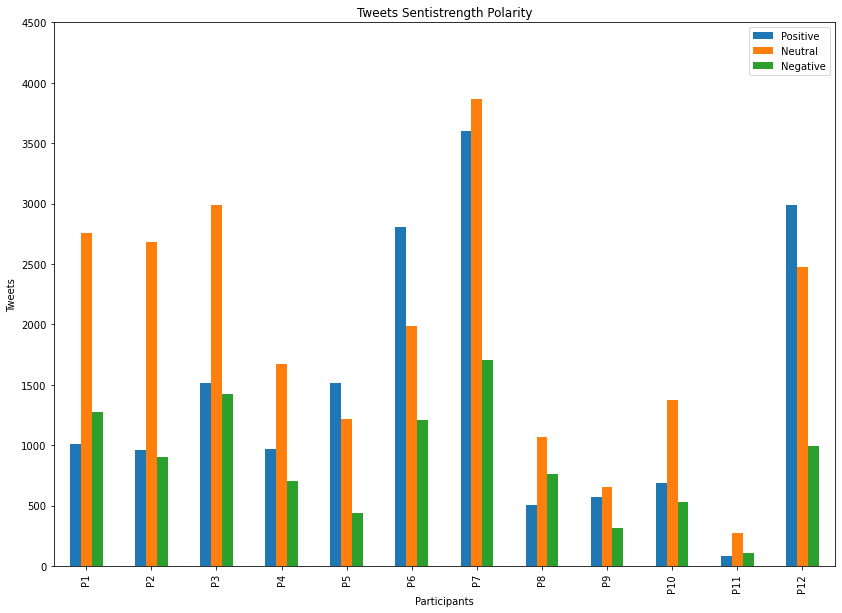

In [12]:
# multiple bar plots

bar_chart_data = []

y_range = range(0,4501, 500)

for i in df_chart.index:
    d = ['P{}'.format(i+1), df_chart.iloc[i]['pos'], df_chart.iloc[i]['neu'], df_chart.iloc[i]['neg']]
    bar_chart_data.append(d)

df = pd.DataFrame(bar_chart_data, columns=["Participant","pos","neu","neg"])
df.plot(yticks = y_range, x="Participant", y=["pos", "neu", "neg"], kind="bar",figsize=(14,10))

plt.legend(["Positive", "Neutral", "Negative"])
plt.title('Tweets Sentistrength Polarity')
plt.xlabel('Participants')
plt.ylabel('Tweets')

plt.show()

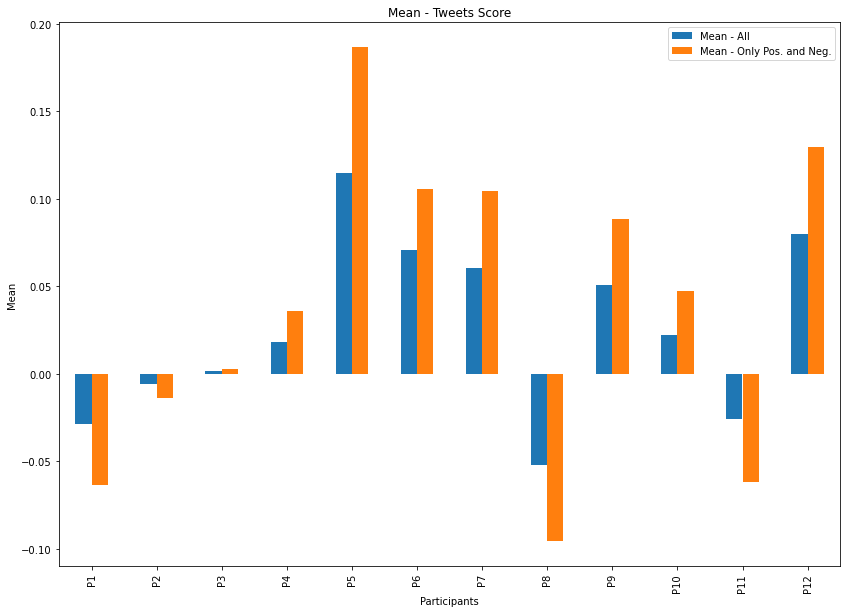

In [13]:
# multiple bar plots with means

bar_chart_data = []

y_range = range(-1,1)

for i in df_chart.index:
    d = ['P{}'.format(i+1), df_chart.iloc[i]['mean_all'], df_chart.iloc[i]['mean_posneg']]
    bar_chart_data.append(d)

df = pd.DataFrame(bar_chart_data, columns=["Participant","mean_all","mean_posneg"])
df.plot(x="Participant", y=["mean_all", "mean_posneg"], kind="bar",figsize=(14,10))

plt.legend(["Mean - All", "Mean - Only Pos. and Neg."])
plt.title('Mean - Tweets Score')
plt.xlabel('Participants')
plt.ylabel('Mean')

plt.show()

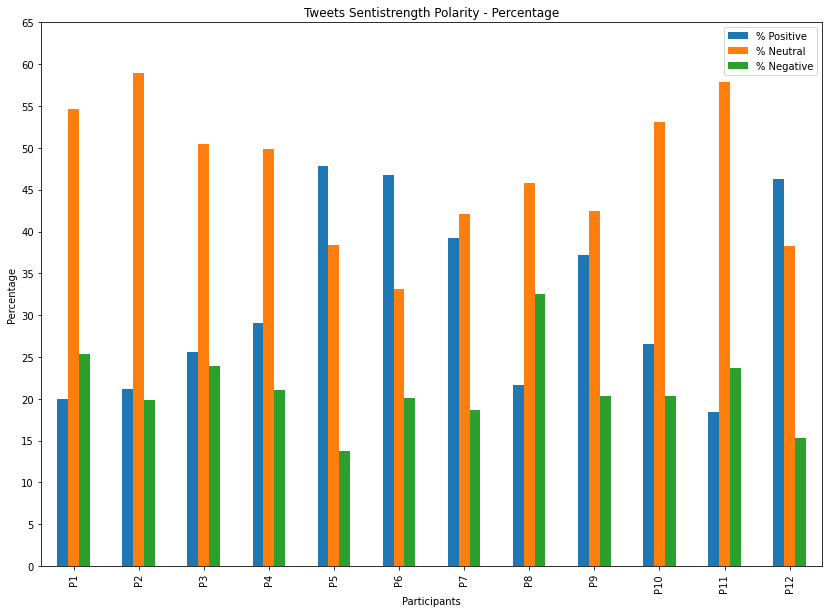

In [14]:
# multiple line plots

bar_chart_data = []

y_range = range(0, 70, 5)

for i in df_chart.index:
    d = ['P{}'.format(i+1), df_chart.iloc[i]['por_pos'], df_chart.iloc[i]['por_neu'], df_chart.iloc[i]['por_neg']]
    bar_chart_data.append(d)

df = pd.DataFrame(bar_chart_data, columns=["Participant","por_pos","por_neu","por_neg"])
df.plot(yticks = y_range, x="Participant", y=["por_pos", "por_neu", "por_neg"], kind="bar",figsize=(14,10))


plt.legend(['% Positive', '% Neutral', '% Negative'])
plt.title('Tweets Sentistrength Polarity - Percentage')
plt.xlabel('Participants')
plt.ylabel('Percentage')

plt.show()

In [15]:
bigfive = {}

for c in data:
    id_user = c

    df_bf = pd.DataFrame(data[id_user]['bigfive'])
    
    if df_bf.empty == False:
        id = int(df_bf[6])

        del df_bf[0]
        del df_bf[6]

        df_bf.columns = ['O', 'C', 'E', 'A', 'N']

        bigfive[id] = df_bf

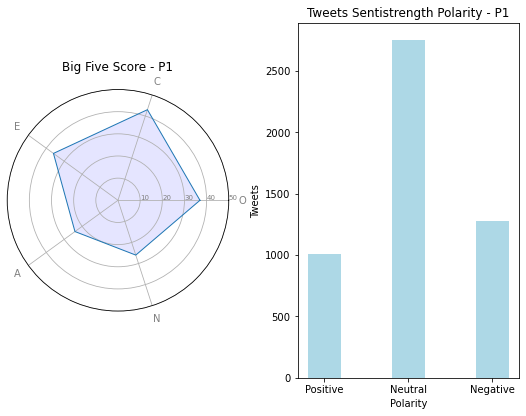

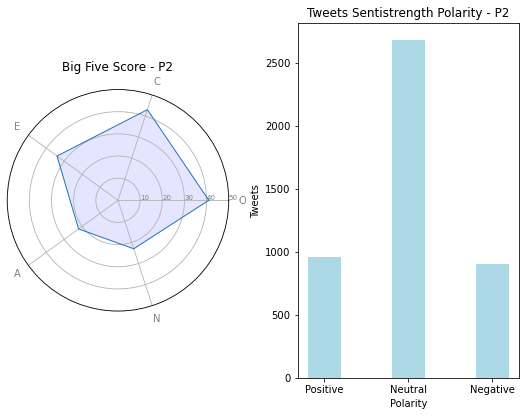

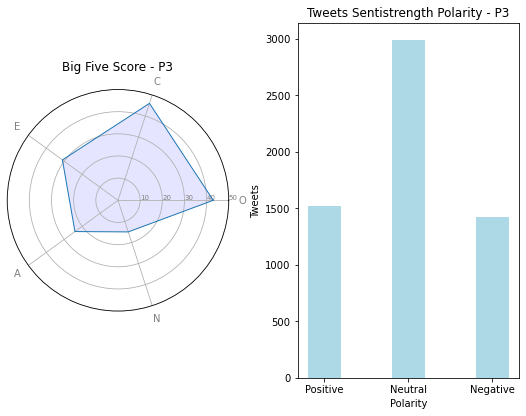

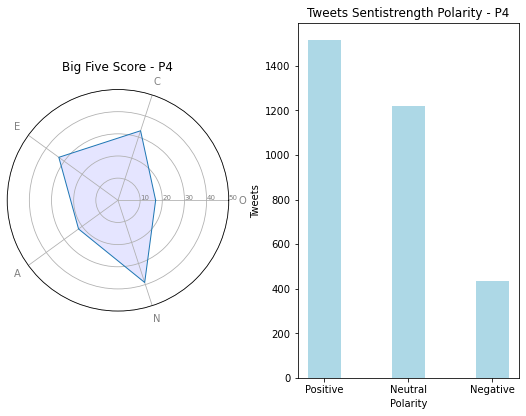

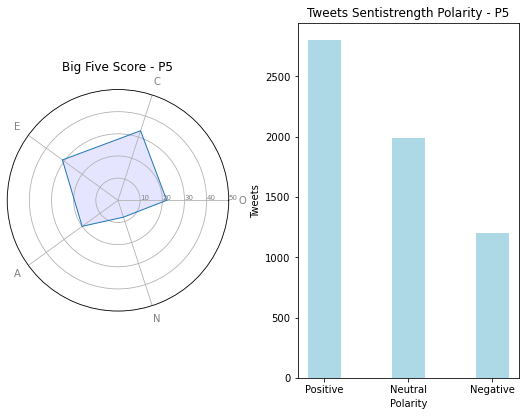

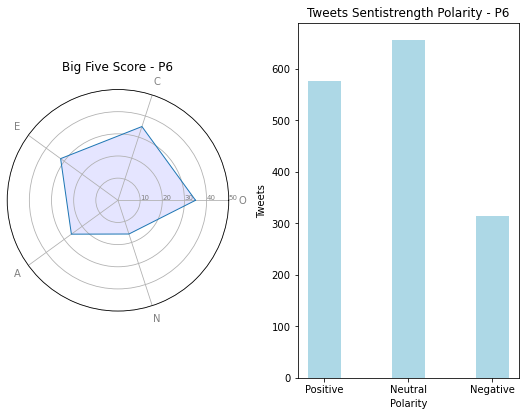

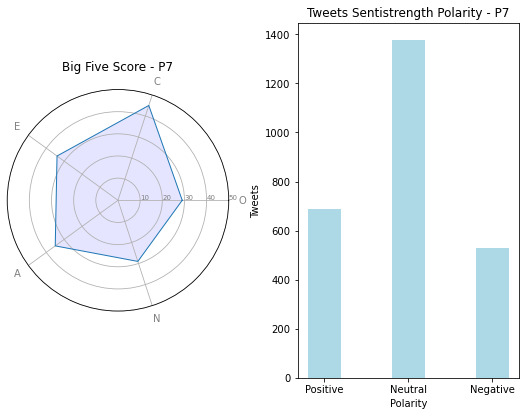

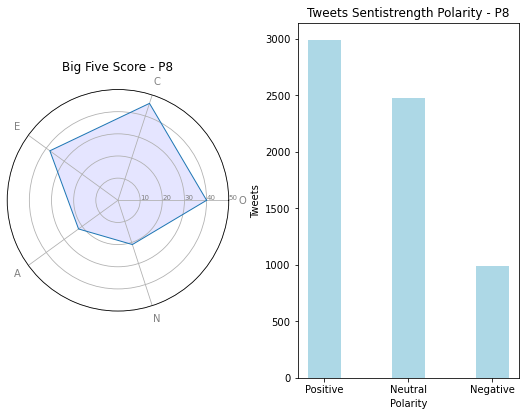

In [16]:
count = 1

for i in bigfive:
    b = bigfive[i]

    o = [b['O']]
    c = [b['C']]
    e = [b['E']]
    a = [b['A']]
    n = [b['N']]

    # Set data
    df = pd.DataFrame({
    'group': ['A'],
    'O': o,
    'C': c,
    'E': e,
    'A': a,
    'N': n
    })

    # number of variable
    categories=list(df)[1:]
    N = len(categories)

    # We are going to plot the first line of the data frame.
    # But we need to repeat the first value to close the circular graph:
    values=df.loc[0].drop('group').values.flatten().tolist()
    values += values[:1]
    values

    # What will be the angle of each axis in the plot? (we divide the plot / number of variable)
    angles = [n / float(N) * 2 * pi for n in range(N)]
    angles += angles[:1]

    
    fig = plt.figure(figsize=(8, 6))
    gs = GridSpec(nrows=1, ncols=2)
    
    # Initialise the spider plot
    ax = fig.add_subplot(gs[0, 0])
    ax = plt.subplot(121, polar=True)

    # Draw one axe per variable + add labels
    plt.xticks(angles[:-1], categories, color='grey', size=10)

    # Draw ylabels
    ax.set_rlabel_position(0)
    plt.yticks([10,20,30, 40, 50], ["10","20","30", '40', '50'], color="grey", size=7)
    plt.ylim(0,50)

    # Plot data
    ax.plot(angles, values, linewidth=1, linestyle='solid')

    # Fill area
    ax.fill(angles, values, 'b', alpha=0.1)
    
    plt.title('Big Five Score - P{}'.format(count))
    
#     plt.tight_layout()

    # Show the graph
#     plt.show()
    
    plt.subplot(122)
    
    y_range = range(0,6001, 500)

    d = {"Positive": int(df_chart.query('id_user == {}'.format(i))['pos']), 
         "Neutral": int(df_chart.query('id_user == {}'.format(i))['neu']), 
         "Negative": int(df_chart.query('id_user == {}'.format(i))['neg'])}
    
#     plt.figure(figsize = (8, 6))

    plt.tight_layout(pad=2.8)
#     plt.subplot_tool()
 
    # creating the bar plot
    plt.bar(d.keys(), d.values(), width = 0.4, color = 'lightblue')

    plt.title('Tweets Sentistrength Polarity - P{}'.format(count))
    plt.xlabel('Polarity')
    plt.ylabel('Tweets')

    plt.show()
    
    count += 1

In [17]:
df_chart

,id_user,pos,neu,neg,por_pos,por_neu,por_neg,mean_all,mean_posneg
0,26,1008,2754,1277,20.003969,54.653701,25.342330,-0.028798,-0.063507
1,27,962,2682,905,21.147505,58.958013,19.894482,-0.005644,-0.013751
2,28,1519,2992,1422,25.602562,50.429799,23.967639,0.001441,0.002907
3,29,973,1670,706,29.053449,49.865632,21.080920,0.017987,0.035877
4,30,1517,1219,436,47.824716,38.430013,13.745271,0.114949,0.186696
5,31,2805,1986,1205,46.781187,33.122081,20.096731,0.070624,0.105602
6,32,3604,3863,1707,39.284936,42.108132,18.606933,0.060513,0.104528
7,33,505,1068,758,21.664522,45.817246,32.518233,-0.051833,-0.095663
8,34,575,656,314,37.216828,42.459547,20.323625,0.050776,0.088244
9,35,689,1378,528,26.551060,53.102119,20.346821,0.022095,0.047112


[Text(1, 0, 'Positive'), Text(2, 0, 'Negative'), Text(3, 0, 'Neutral')]

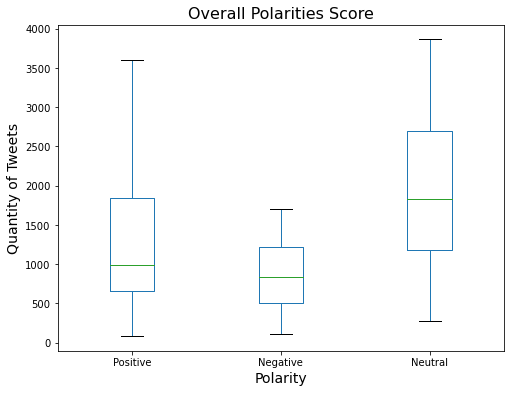

In [18]:
bplot = df_chart.boxplot(column=['pos', 'neg', 'neu'], grid=False, figsize=(8,6))

bplot.axes.set_title("Overall Polarities Score", fontsize=16)
 
bplot.set_xlabel("Polarity", fontsize=14) 
bplot.set_ylabel("Quantity of Tweets", fontsize=14)
bplot.tick_params(labelsize=10)
bplot.set_xticklabels(['Positive', 'Negative', 'Neutral'])

[Text(1, 0, 'Positive (%)'),
 Text(2, 0, 'Negative (%)'),
 Text(3, 0, 'Neutral (%)')]

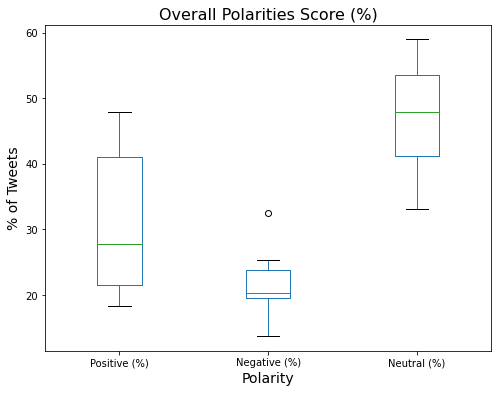

In [19]:
bplot = df_chart.boxplot(column=['por_pos', 'por_neg', 'por_neu'], grid=False, figsize=(8,6))

bplot.axes.set_title("Overall Polarities Score (%)", fontsize=16)
 
bplot.set_xlabel("Polarity", fontsize=14) 
bplot.set_ylabel("% of Tweets", fontsize=14)
bplot.tick_params(labelsize=10)
bplot.set_xticklabels(['Positive (%)', 'Negative (%)', 'Neutral (%)'])

[Text(1, 0, 'All Polarities'), Text(2, 0, 'Only Positives and Negatives')]

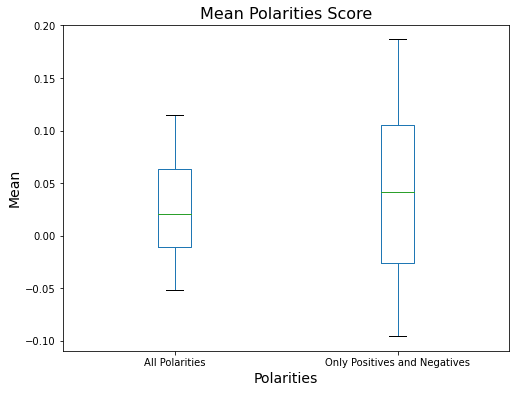

In [20]:
bplot = df_chart.boxplot(column=['mean_all', 'mean_posneg'], grid=False, figsize=(8,6))

bplot.axes.set_title("Mean Polarities Score", fontsize=16)
 
bplot.set_xlabel("Polarities", fontsize=14) 
bplot.set_ylabel("Mean", fontsize=14)
bplot.tick_params(labelsize=10)
bplot.set_xticklabels(['All Polarities', 'Only Positives and Negatives'])

In [21]:
def plot_point_chart(df, count, id_user):

    first_date = df.iloc[0]['date_minus_time']
    
    for i in range(1,13):
        end_date = first_date + relativedelta(months=+3)
        mask = (df['created_at'] >= first_date) & (df['created_at'] < end_date)
        new_df = df.loc[mask]
        
        fig, ax = plt.subplots(figsize=(24, 8))
    
        x = new_df['date_minus_time']
        y = new_df[alg_to_analyze[0]]

        x_ticks = x

        colors = {'pos':'green', 'neu':'orange', 'neg':'red'}

        plt.yticks(np.arange(-1.0, 1.1, 0.1), fontsize=16)
        plt.xticks(x_ticks, rotation='vertical', fontsize=16)

        date_form = DateFormatter("%Y-%m-%d")
        ax.xaxis.set_major_formatter(date_form)
        plt.xlabel('Day', fontsize=16)
        plt.ylabel('Polarity Sentistrength Score', fontsize=16)
        
        plt.title('Scatter Plot - Sentistrength - P{}, User {} - From {} To {}'.format(count, id_user, first_date.strftime("%Y-%m-%d"), end_date.strftime("%Y-%m-%d")), fontsize=20)
        
        plt.rcParams.update({
            "savefig.facecolor": (1.0, 1.0, 1.0)
        })
        
#         plt.legend()

        plt.scatter(x, y, alpha=0.7, c=new_df[alg_to_analyze[1]].map(colors))
        
#         plt.savefig('images/scatter_P{}_U{}_{}_{}.pdf'.format(count, id_user, first_date.strftime("%Y-%m-%d"), end_date.strftime("%Y-%m-%d")),bbox_inches='tight',transparent=False)
        
        first_date = end_date

/Users/leosilva/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # Remove the CWD from sys.path while we load stuff.


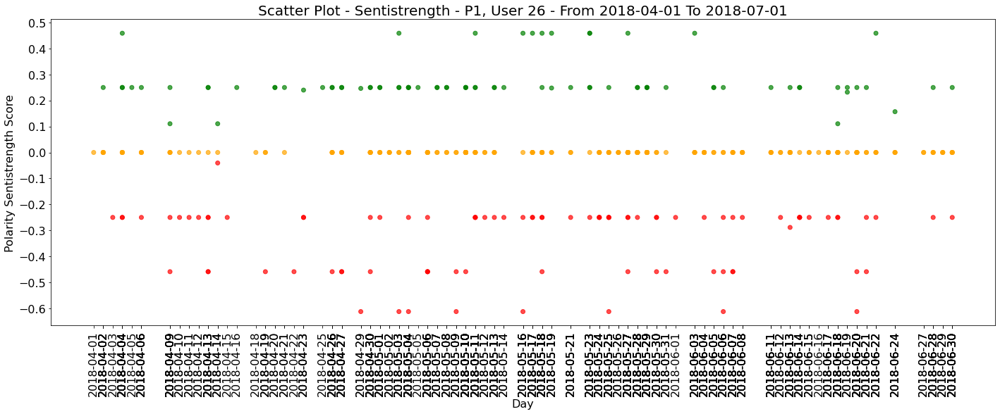

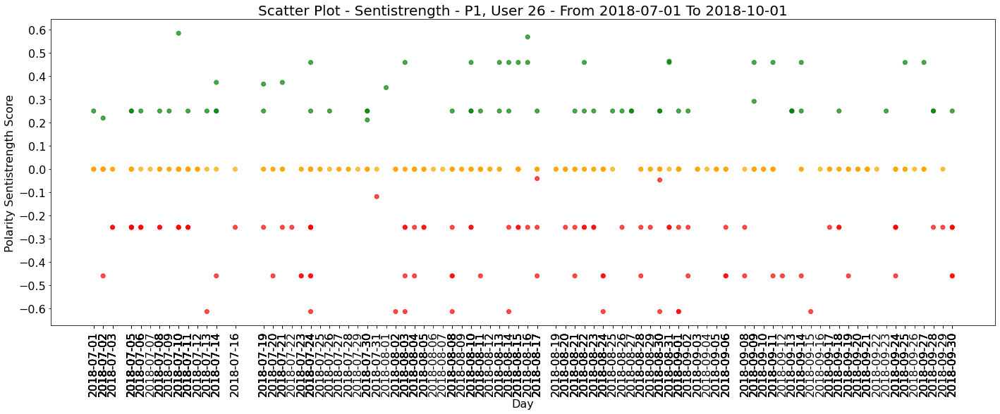

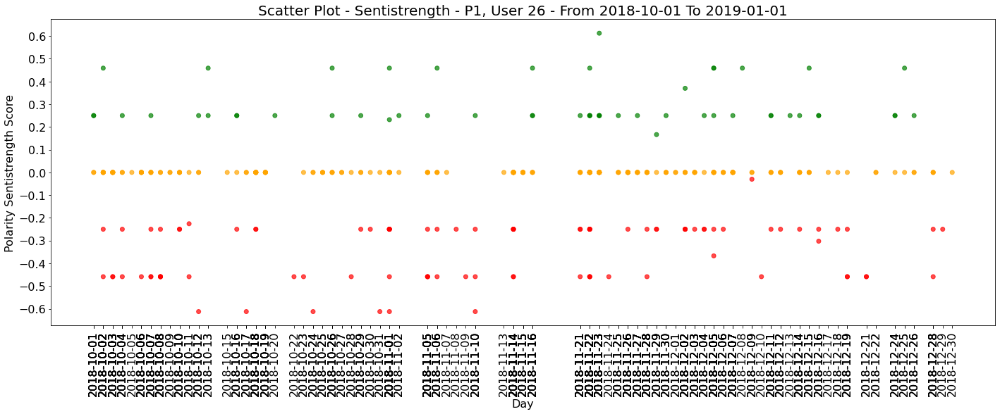

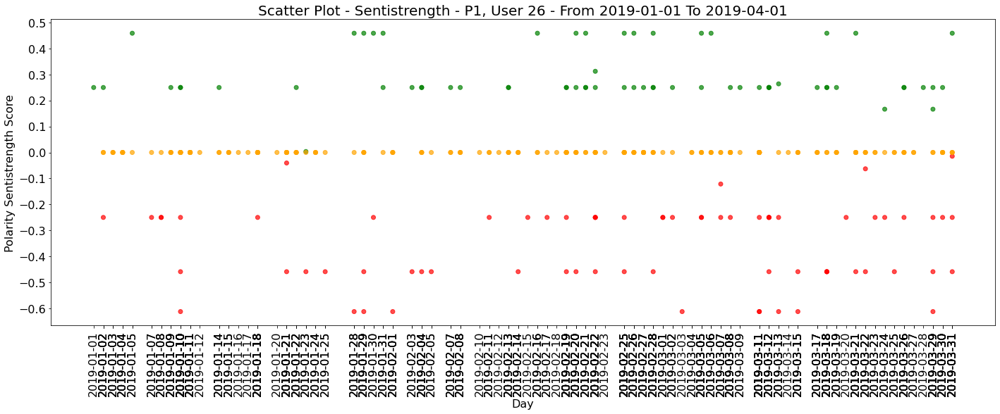

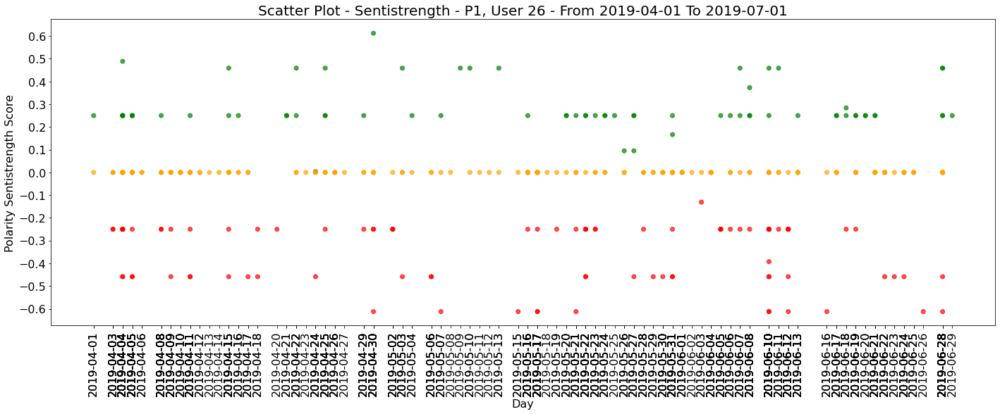

...

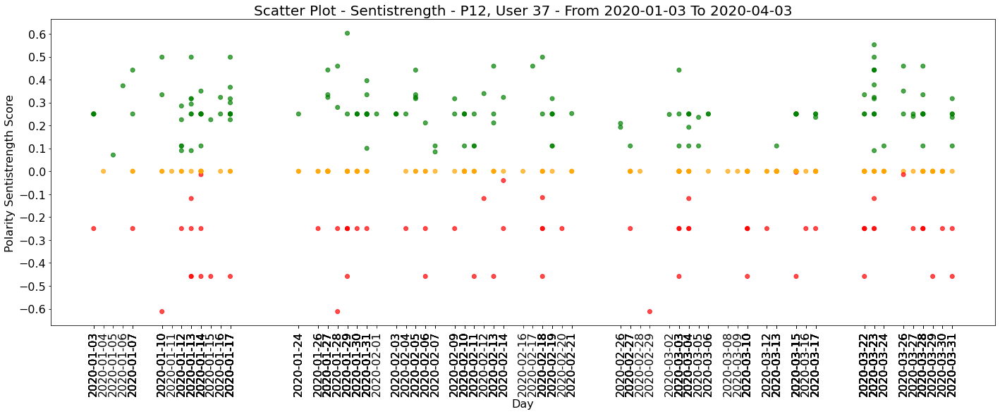

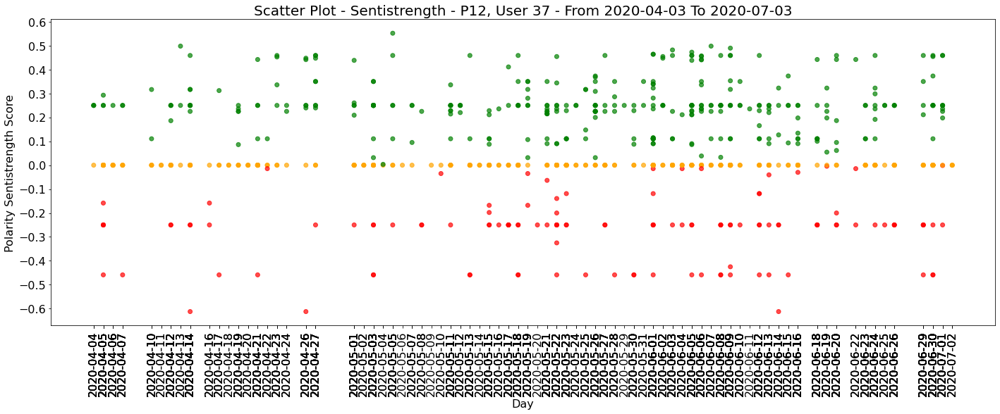

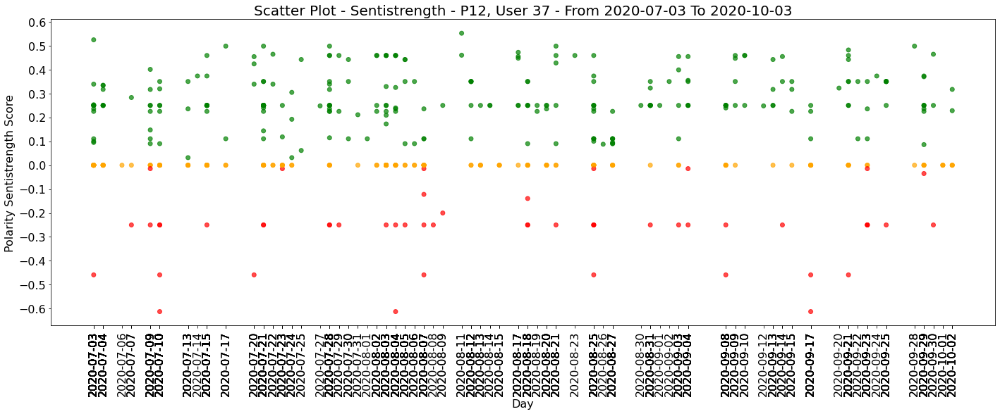

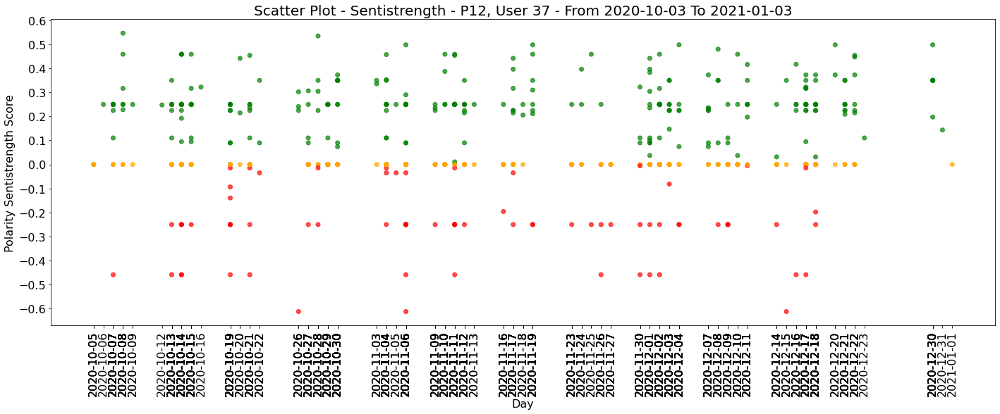

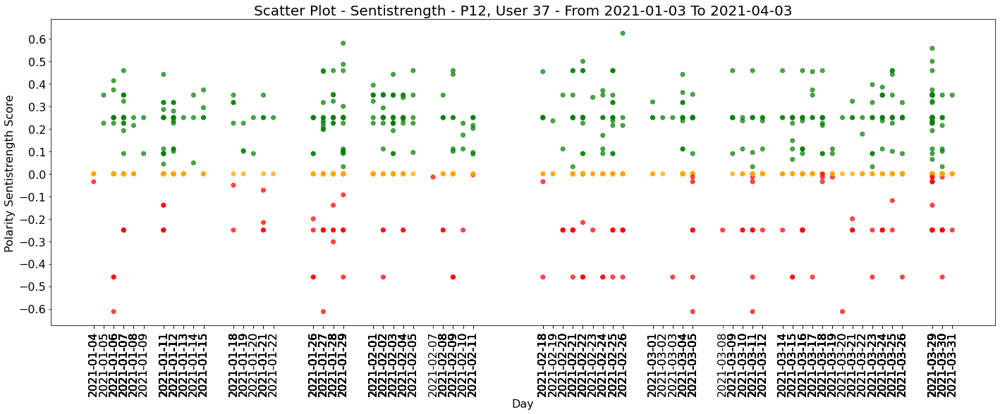

In [22]:
count = 1
for c in data:
    id_user = c
    tweets_pd = create_tweets_pd(data, id_user)
    df = pd.DataFrame(tweets_pd)
    clean_df(df)
    
    df = df.sort_values(by='created_at')
    
    df["created_at"] = pd.to_datetime(df["created_at"])
    df['date_minus_time'] = df["created_at"].apply( lambda df : datetime.datetime(year=df.year, month=df.month, day=df.day))
#     df.set_index(df["date_minus_time"],inplace=True)
    
    plot_point_chart(df, count, id_user)
    
    count += 1

In [23]:
tweets_pd = create_tweets_pd(data, id_user)
df = pd.DataFrame(tweets_pd)
df.head()

,text,created_at,id_user,vader_sentiment_analysis_score,vader_sentiment_analysis_polarity,oplexicon_sentiment_analysis_score,oplexicon_sentiment_analysis_polarity,sentistrength_sentiment_analysis_score,sentistrength_sentiment_analysis_polarity,sentilexpt_sentiment_analysis_score,sentilexpt_sentiment_analysis_polarity,final_score,final_polarity
0,@haggen É um dos grandes mistérios da tecnologia,2021-03-31T18:48:36,37,0.2960,pos,0.00,neu,0.00,neu,0.000,neu,0.074000,pos
1,@fazdenise inclusive quem não trampa lá hahaha,2021-03-31T18:47:57,37,0.3400,pos,0.00,neu,0.00,neu,-0.250,neg,0.022500,pos
2,@DouglasAmarelo Sim! O Spotify consegue fazer ...,2021-03-31T18:47:31,37,0.6360,pos,0.25,pos,0.00,neu,0.250,pos,0.284000,pos
3,StackOverflow ficou fora do ar e fiquei me per...,2021-03-31T16:17:26,37,-0.2263,neg,0.00,neu,-0.25,neg,-0.250,neg,-0.181575,neg
4,@Willian_justen @ludevsz e nada melhor pra est...,2021-03-31T12:23:38,37,0.4404,pos,0.35,pos,0.35,pos,0.225,pos,0.341350,pos


In [24]:
def plot_point_chart_pos_neg(df, count, id_user):

    first_date = df.index[0]
    
    for i in range(1,13):
        
        fig, ax = plt.subplots(figsize=(24, 8))

        end_date = first_date + relativedelta(months=+3)
        mask = (df.index >= first_date) & (df.index < end_date)
        new_df = df.loc[mask]
        
        x_ticks = new_df.index

        plt.xticks(x_ticks, rotation='vertical', fontsize=16)
        plt.yticks(np.arange(-1.0, 1.1, 0.1), fontsize=16)
        plt.xlabel('Day', fontsize=16)
        plt.ylabel('Polarity Score Mean', fontsize=16)

        date_form = DateFormatter("%Y-%m-%d")
        ax.xaxis.set_major_formatter(date_form)
    
        x = new_df.index
        y1 = new_df['sentistrength_score_pos']
        y2 = new_df['sentistrength_score_neg']
        y3 = new_df['mean']

        plt.title('Scatter Plot - Polarity Means - Sentistrength - P{}, User {} - From {} To {}'.format(count, id_user, first_date.strftime("%Y-%m-%d"), end_date.strftime("%Y-%m-%d")), fontsize=20)
        
        plt.rcParams.update({
            "savefig.facecolor": (1.0, 1.0, 1.0)
        })
        
        plt.axhline(y=0.0, color='orange', linestyle='-', alpha=0.7, linewidth=4)
        
#         # plotting the line 1 points 
#         plt.scatter(new_df.index, new_df['final_score_pos'], label = "pos", marker='o', color = 'green')

#         # plotting the line 2 points 
#         plt.scatter(new_df.index, new_df['final_score_neg'], label = "neg", marker='o', color = 'red')
        
        
        # plotting the line 1 points 
        plt.plot(new_df.index, new_df['sentistrength_score_pos'], label = "pos", marker='o', markerfacecolor='none', color = 'green')

        # plotting the line 2 points 
        plt.plot(new_df.index, new_df['sentistrength_score_neg'], label = "neg", marker='o', markerfacecolor='none', color = 'red')
        
        # plotting the line 3 points 
        plt.plot(new_df.index, new_df['mean'], label = "mean", marker='o', markerfacecolor='none', color = 'gray', linestyle='--')
        
        plt.legend()
        
#         plt.savefig('images/scatter_pol_means_P{}_U{}_{}_{}.pdf'.format(count, id_user, first_date.strftime("%Y-%m-%d"), end_date.strftime("%Y-%m-%d")),bbox_inches='tight',transparent=False)
        
        plt.show()
        
        first_date = end_date

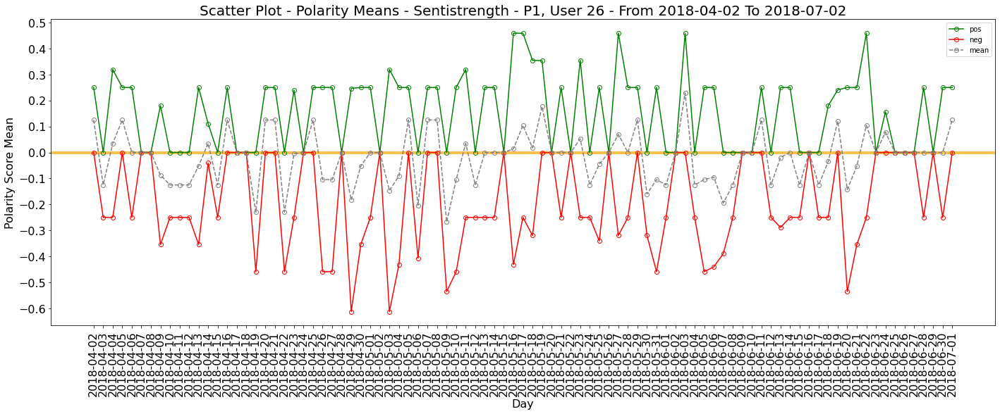

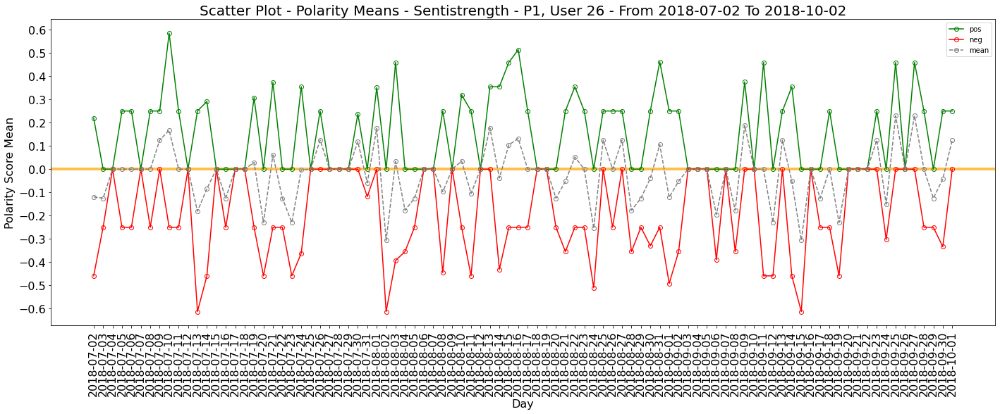

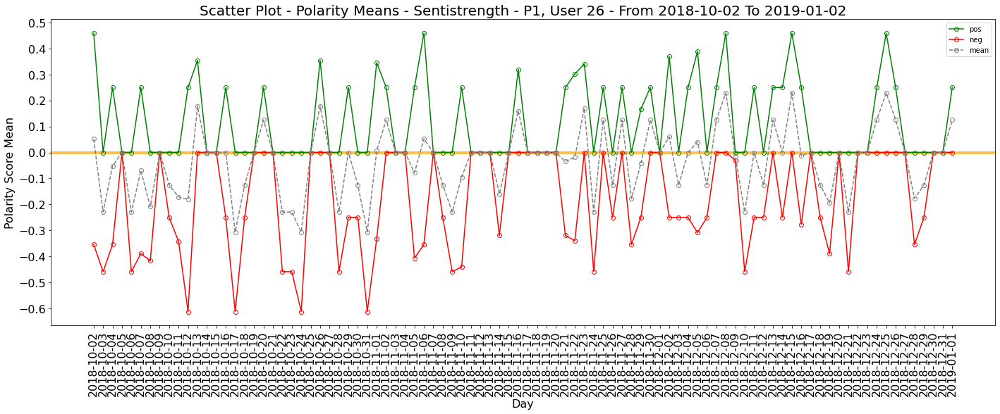

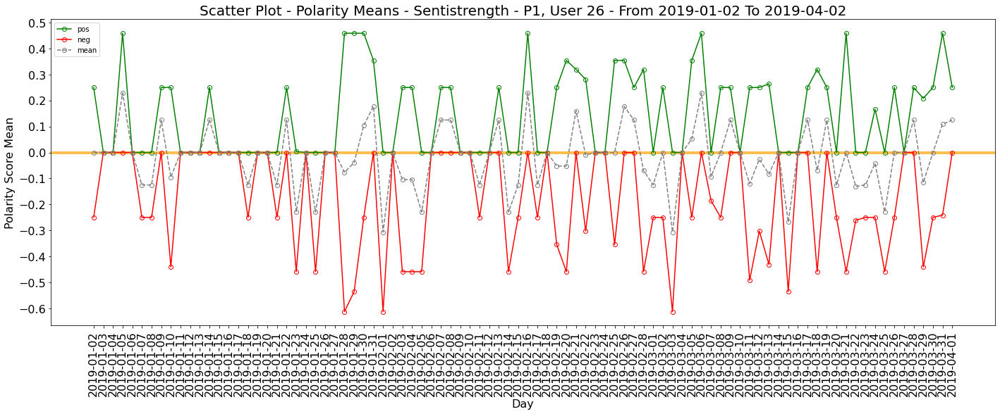

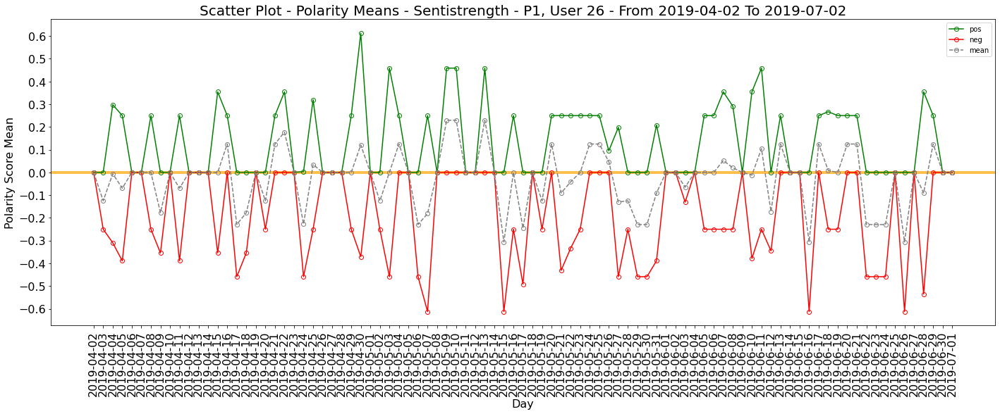

...

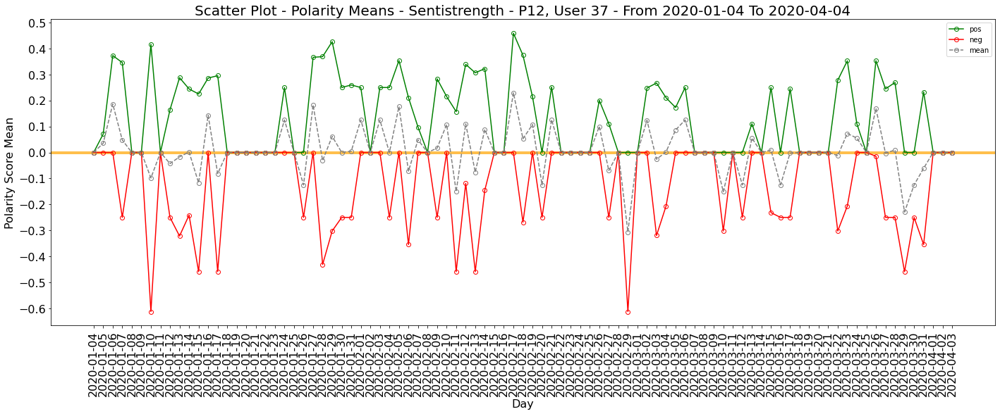

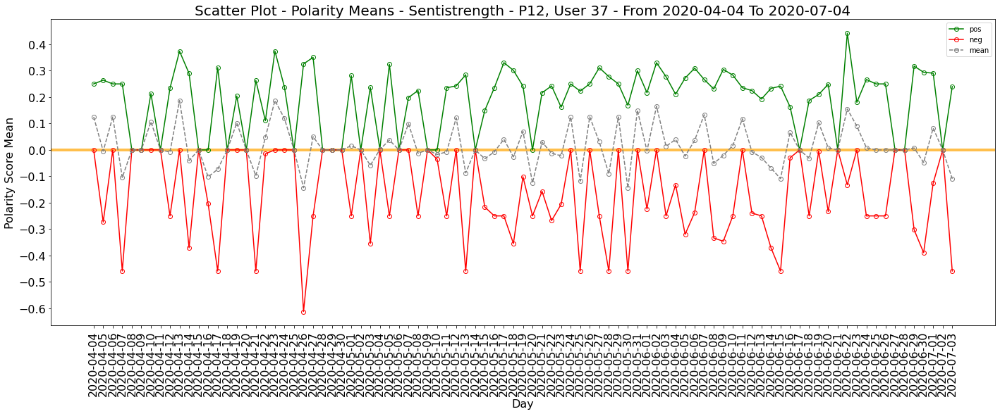

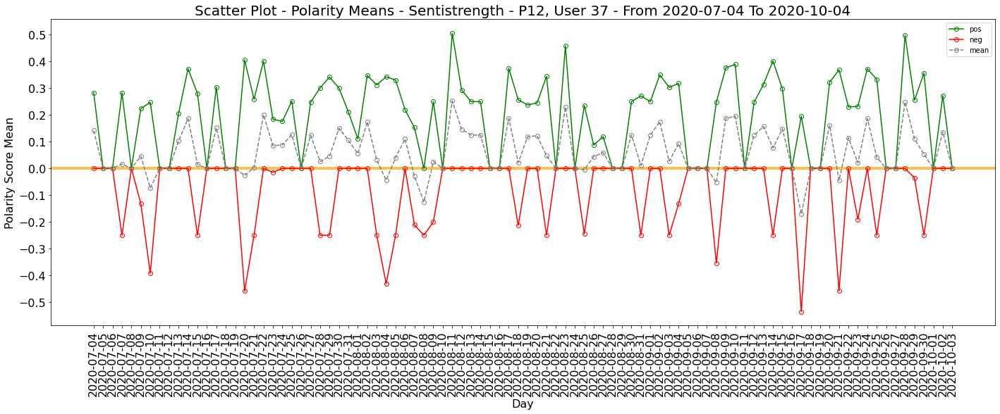

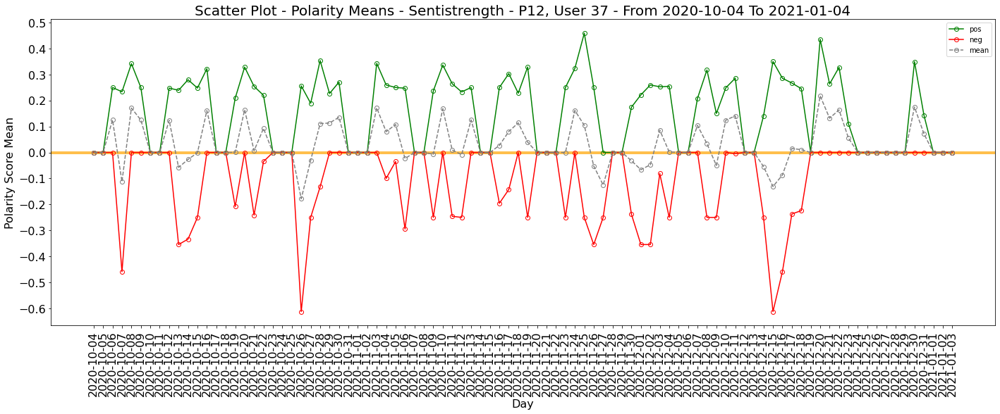

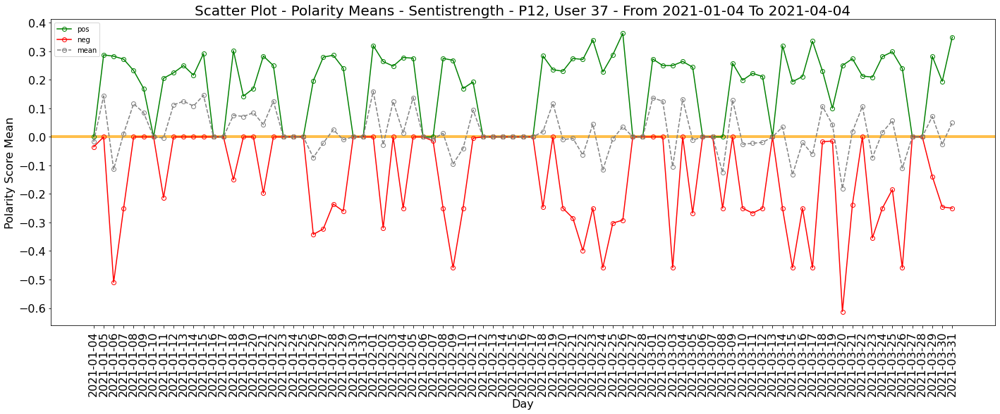

In [25]:
count = 1
for c in data:
    id_user = c
    tweets_pd = create_tweets_pd(data, id_user)
    df = pd.DataFrame(tweets_pd)
    clean_df(df)
    
    df = df.sort_values(by='created_at')
    
    df["created_at"] = pd.to_datetime(df["created_at"])
    df['date_minus_time'] = df["created_at"].apply( lambda df : datetime.datetime(year=df.year, month=df.month, day=df.day))
    df.set_index(df["date_minus_time"],inplace=True)
    
    df_pos = df.query(alg_to_analyze[1] + " == 'pos'")
    df_pos = pd.DataFrame(df_pos[alg_to_analyze[0]].resample('D').mean())
    
    df_neg = df.query(alg_to_analyze[1] + " == 'neg'")
    df_neg = pd.DataFrame(df_neg[alg_to_analyze[0]].resample('D').mean())
    
    df_final = pd.merge(df_pos, df_neg, how="outer", on=["date_minus_time"])
    df_final = df_final.fillna(0)
    df_final.columns = ['sentistrength_score_pos', 'sentistrength_score_neg']
    
    df_final['mean'] = df_final.iloc[:, [0,1]].mean(axis=1)
    
    plot_point_chart_pos_neg(df_final, count, id_user)
    
    count += 1

In [26]:
# Function to calculate correlation coefficient between two arrays
def corr(x, y, **kwargs):
    
    # Calculate the value
    coef = np.corrcoef(x, y)[0][1]
    # Make the label
    label = r'$\rho$ = ' + str(round(coef, 2))
    
    # Add the label to the plot
    ax = plt.gca()
    ax.annotate(label, xy = (0.2, 0.95), size = 20, xycoords = ax.transAxes)

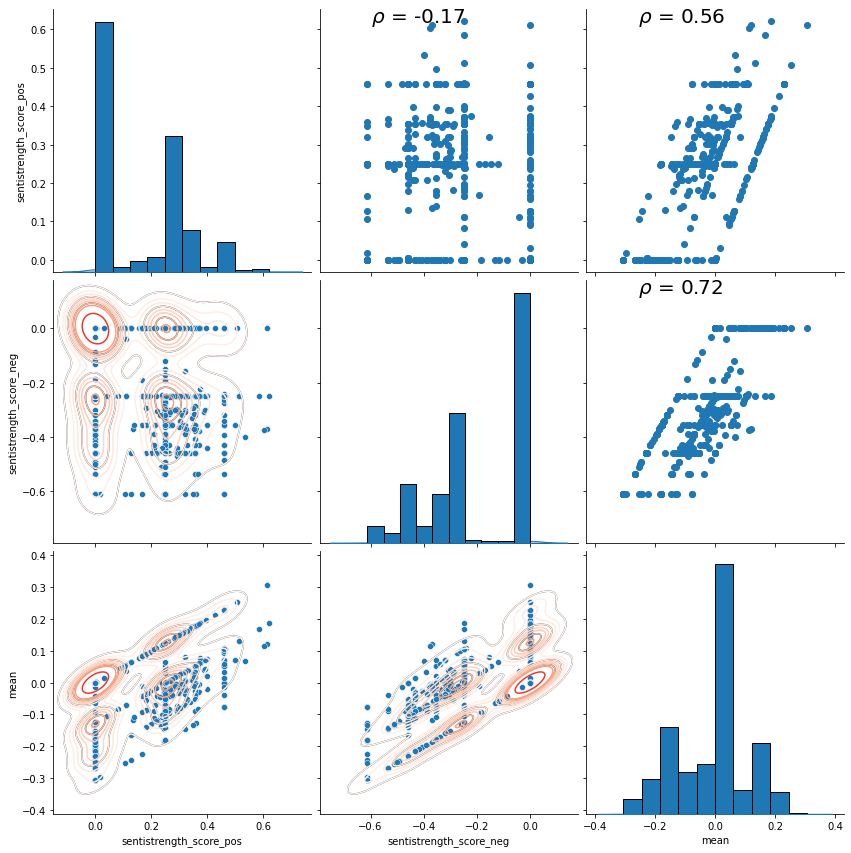

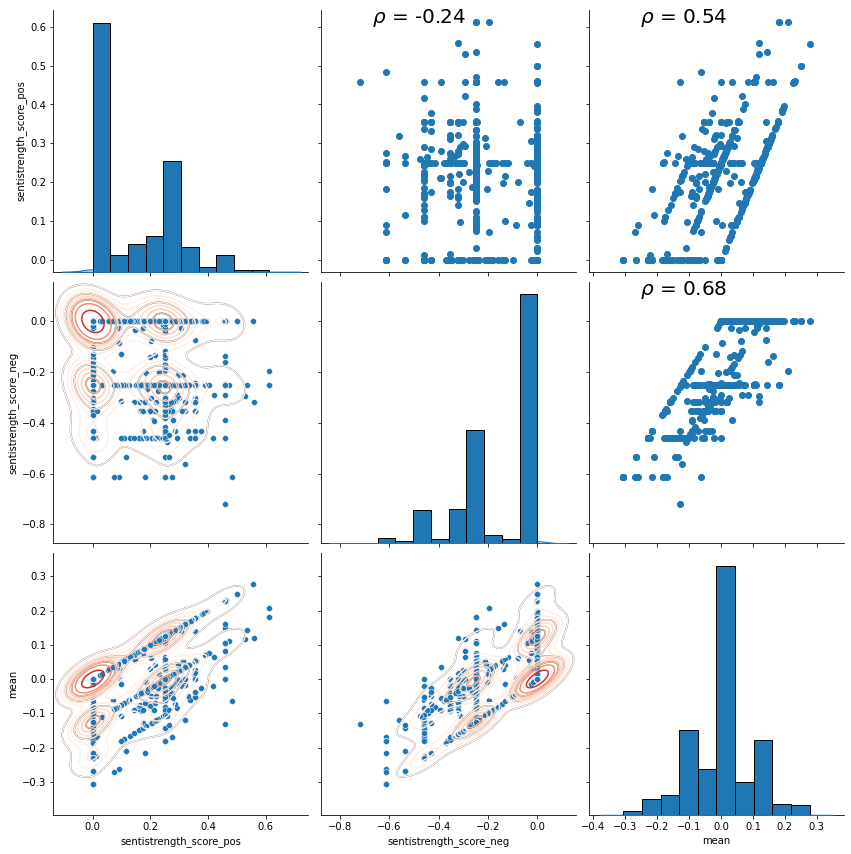

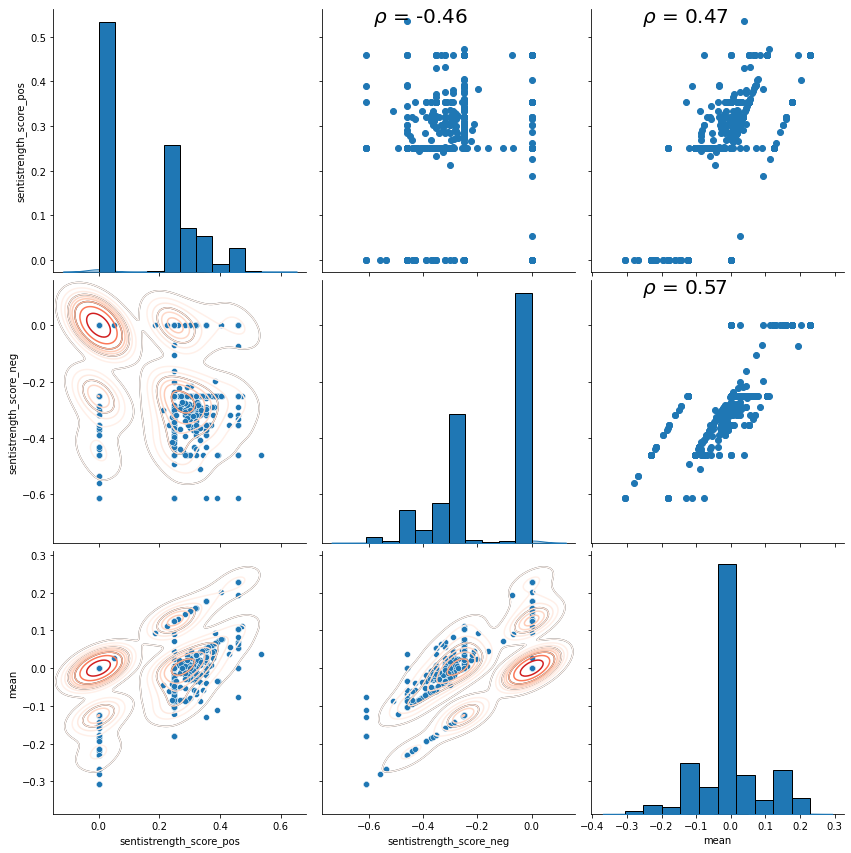

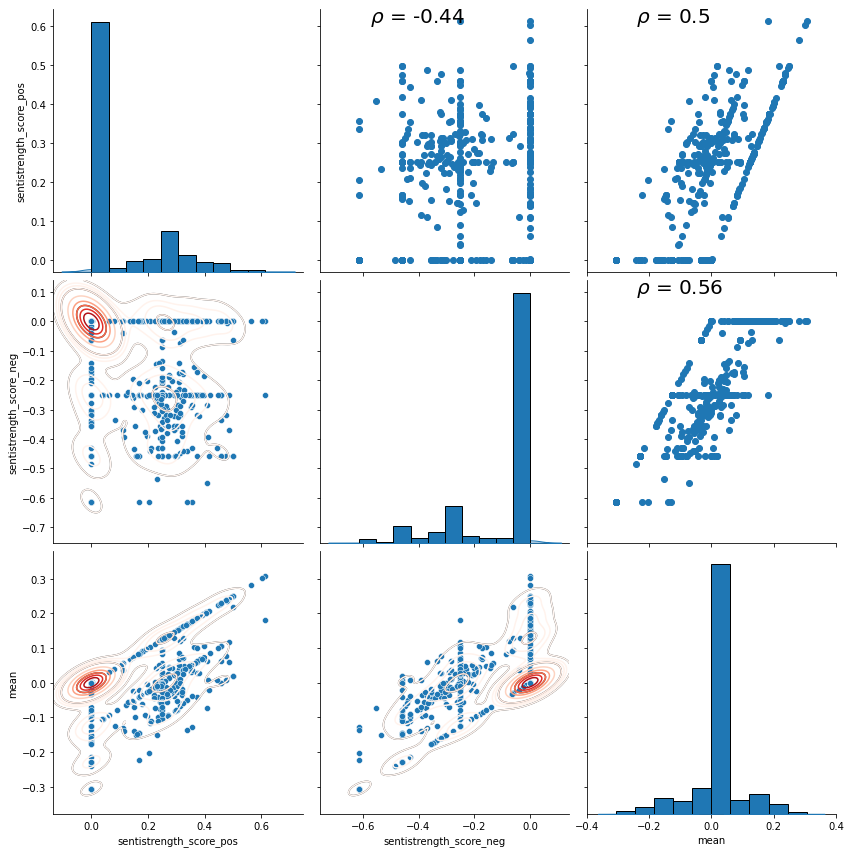

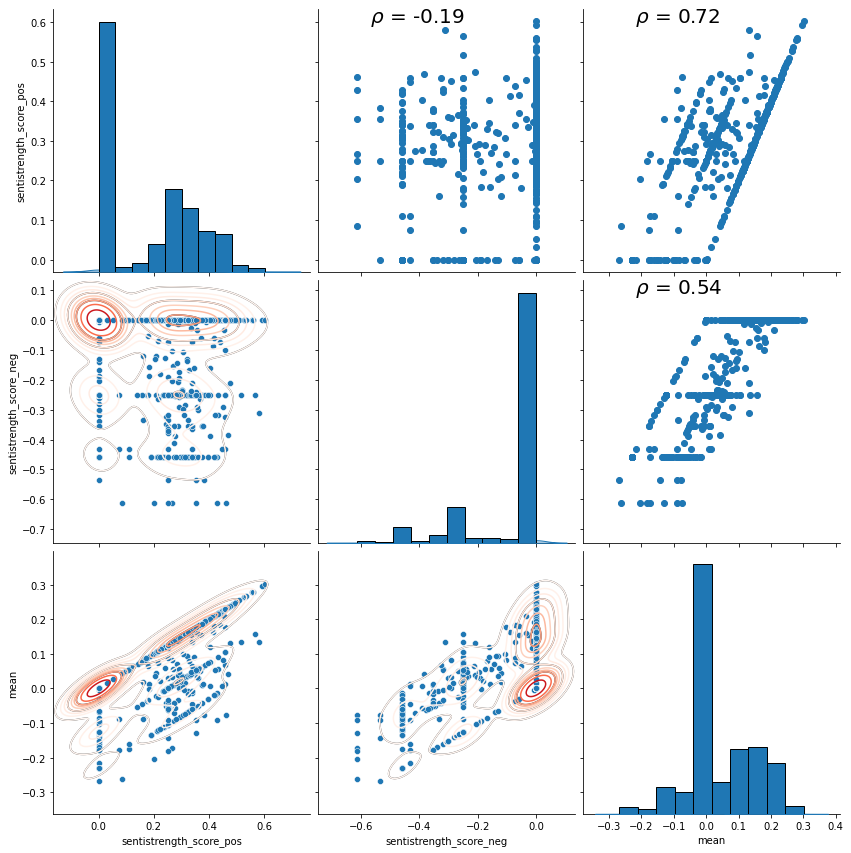

...

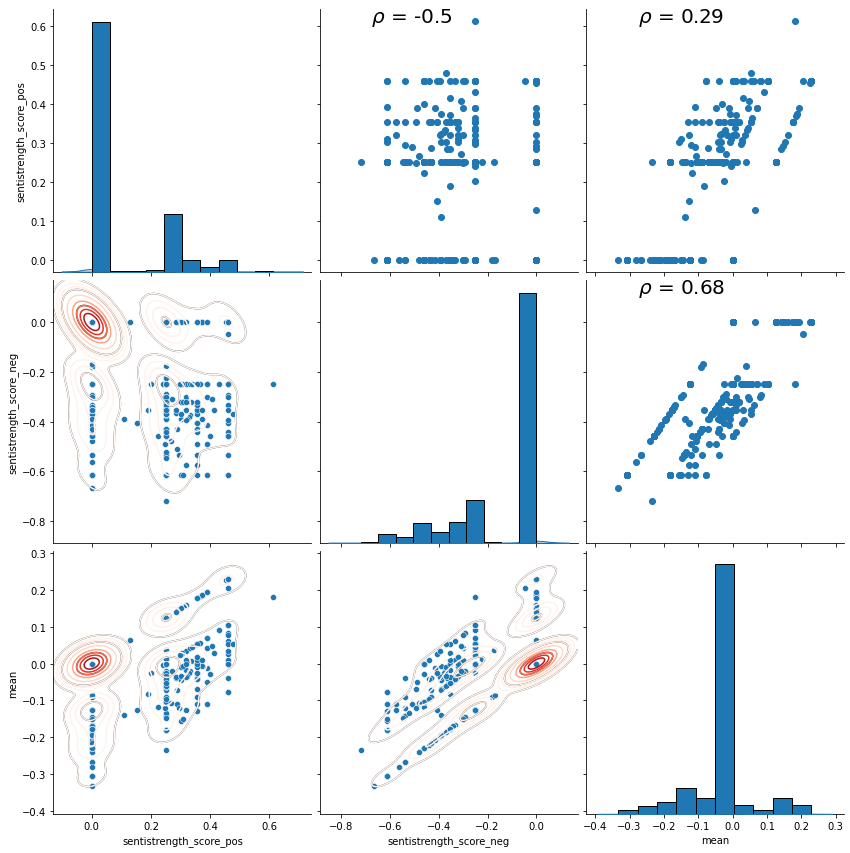

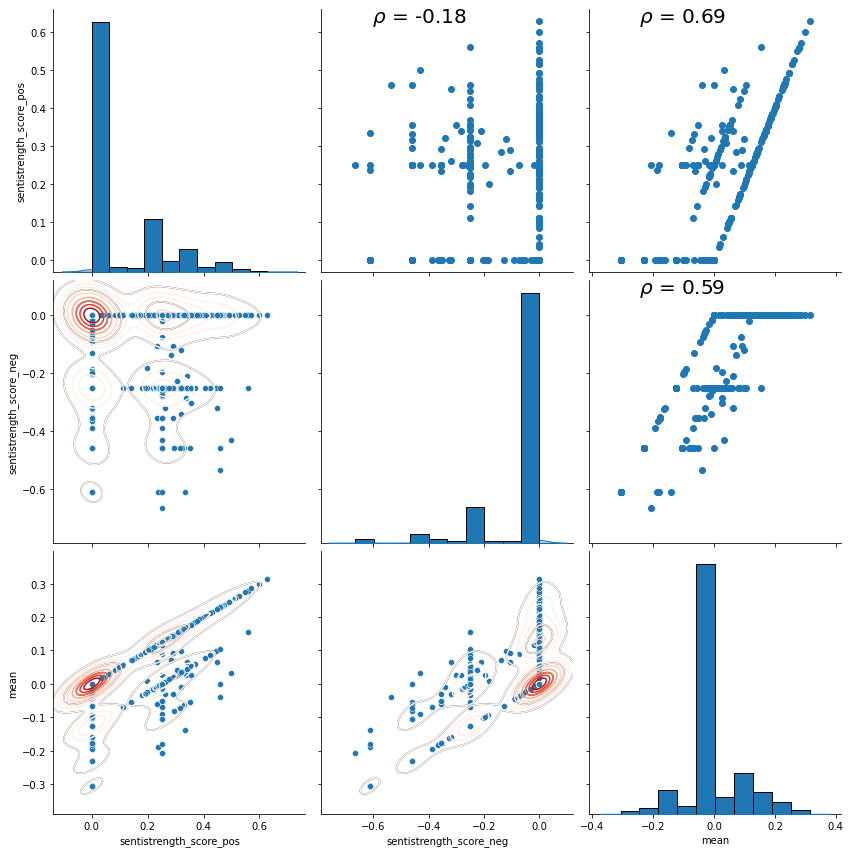

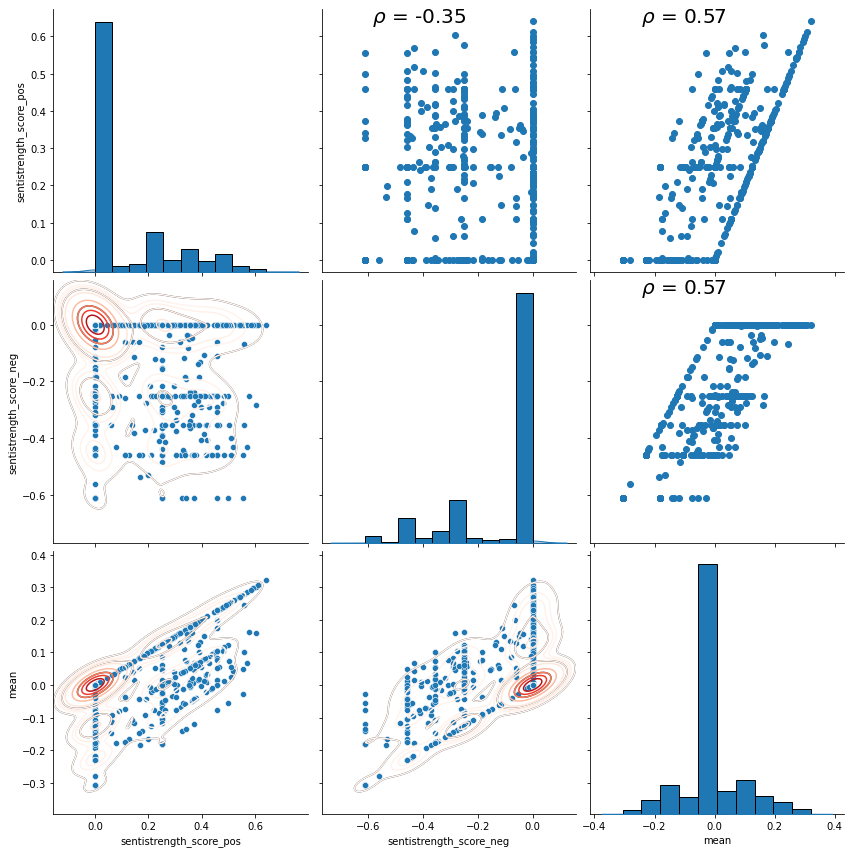

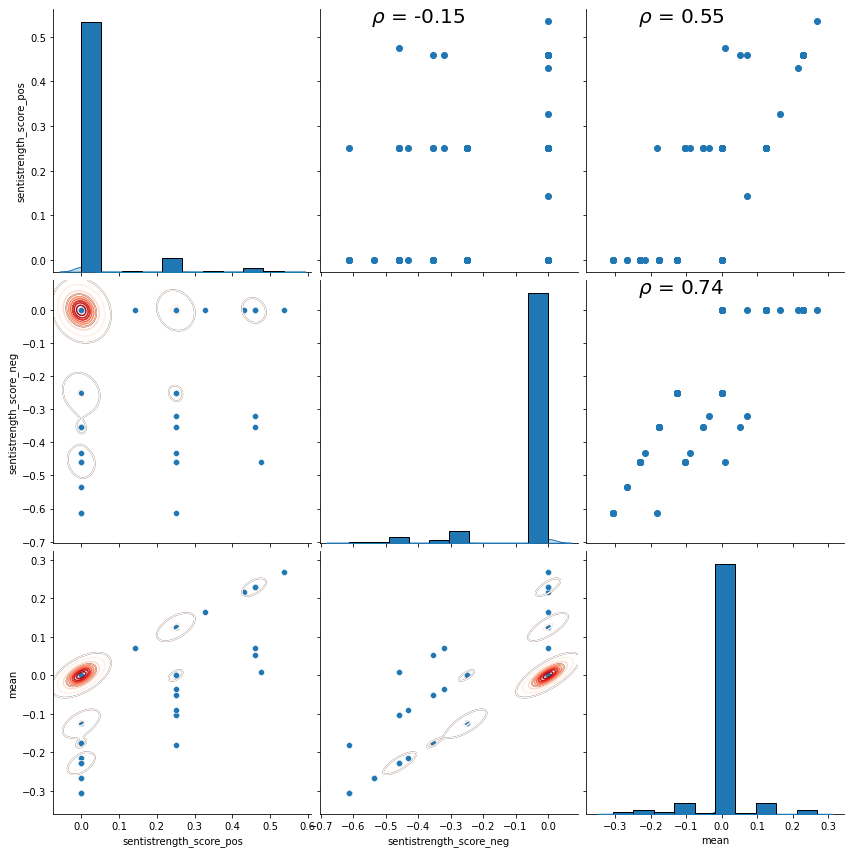

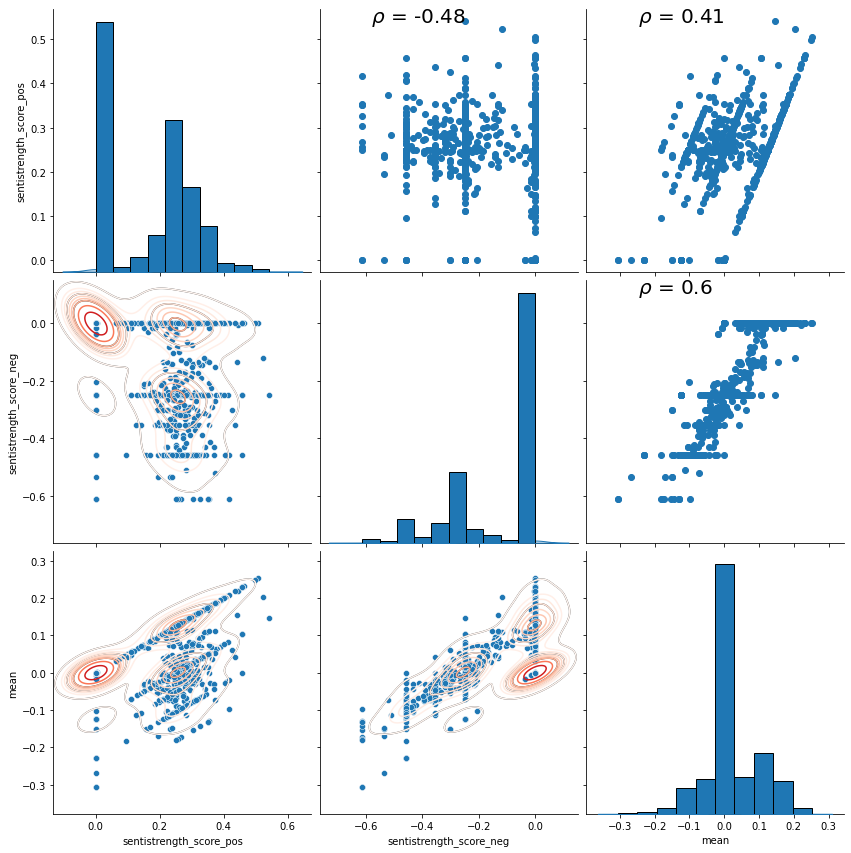

In [27]:
count = 1
for c in data:
    id_user = c
    tweets_pd = create_tweets_pd(data, id_user)
    df = pd.DataFrame(tweets_pd)
    
    clean_df(df)

    df = df.sort_values(by='created_at')

    df["created_at"] = pd.to_datetime(df["created_at"])
    df['date_minus_time'] = df["created_at"].apply( lambda df : datetime.datetime(year=df.year, month=df.month, day=df.day))
    df.set_index(df["date_minus_time"],inplace=True)

    df_pos = df.query(alg_to_analyze[1] + " == 'pos'")
    df_pos = pd.DataFrame(df_pos[alg_to_analyze[0]].resample('D').mean())

    df_neg = df.query(alg_to_analyze[1] + " == 'neg'")
    df_neg = pd.DataFrame(df_neg[alg_to_analyze[0]].resample('D').mean())

    df_final = pd.merge(df_pos, df_neg, how="outer", on=["date_minus_time"])
    df_final = df_final.fillna(0)
    df_final.columns = ['sentistrength_score_pos', 'sentistrength_score_neg']

    df_final['mean'] = df_final.iloc[:, [0,1]].mean(axis=1)

    g = sns.pairplot(df_final, diag_kind="kde", height=4)
    g.map_lower(sns.kdeplot, levels=4, color=".2")

    # Map the plots to the locations
    g = g.map_upper(plt.scatter)
    g = g.map_upper(corr)
    g = g.map_lower(sns.kdeplot, cmap = 'Reds')
    g = g.map_diag(plt.hist, bins = 10, edgecolor =  'k');
    
    count += 1

In [28]:
df_final

,sentistrength_score_pos,sentistrength_score_neg,mean
date_minus_time,,,
2018-04-04,0.444013,-0.004416,0.219799
2018-04-05,0.286083,-0.250000,0.018042
2018-04-06,0.284666,-0.250000,0.017333
2018-04-07,0.000000,0.000000,0.000000
2018-04-08,0.000000,0.000000,0.000000
...,...,...,...
2021-03-28,0.000000,0.000000,0.000000
2021-03-29,0.282367,-0.138492,0.071938
2021-03-30,0.194625,-0.245555,-0.025465


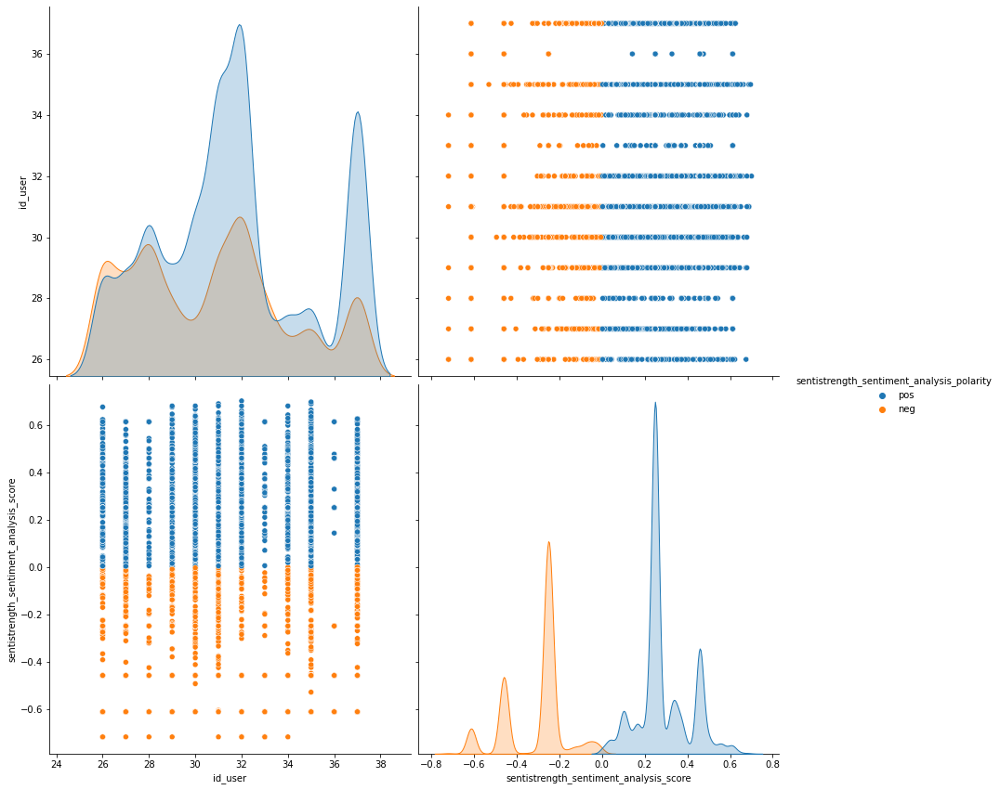

In [29]:
tweets = [data[d]['tweets'] for d in data]

final_tweets = []
for i in tweets:
    final_tweets.extend(i)

df = pd.DataFrame(final_tweets)

del df[0]
del df[1]
del df[4]
del df[5]
del df[6]
del df[18]

df.columns = ["text", "created_at", "id_user", "vader_sentiment_analysis_score", "vader_sentiment_analysis_polarity",
                         "oplexicon_sentiment_analysis_score", "oplexicon_sentiment_analysis_polarity",
                         "sentistrength_sentiment_analysis_score", "sentistrength_sentiment_analysis_polarity",
                         "sentilexpt_sentiment_analysis_score", "sentilexpt_sentiment_analysis_polarity",
                         "final_score", "final_polarity"]

clean_df(df)

df = df.sort_values(by='created_at')

# print(df)

df["created_at"] = pd.to_datetime(df["created_at"])
df['date_minus_time'] = df["created_at"].apply( lambda df : datetime.datetime(year=df.year, month=df.month, day=df.day))
# df.set_index(df["date_minus_time"],inplace=True)

df_final = df.query(alg_to_analyze[1] + " == 'pos' or " + alg_to_analyze[1] + " == 'neg'")

# df_pos = pd.DataFrame(df_pos['final_score'].resample('D').mean())
# df_pos['final_score_mean'] = df_pos['final_score'].resample('D').mean()

# print(df_pos)


# df_neg = df.query("final_polarity == 'neg'")
# df_neg = pd.DataFrame(df_neg['final_score'].resample('D').mean())

# df_final = pd.merge(df_pos, df_neg, how="outer", on=["date_minus_time"])
# df_final = df_final.fillna(0)
# df_final.columns = ['final_score_pos', 'final_score_neg']

# df_final['mean'] = df_final.iloc[:, [0,1]].mean(axis=1)

# df_final.head()

sns.pairplot(df_final, diag_kind="kde", height=6, hue=alg_to_analyze[1])

Text(0.5, 1.02, 'PairPlot')

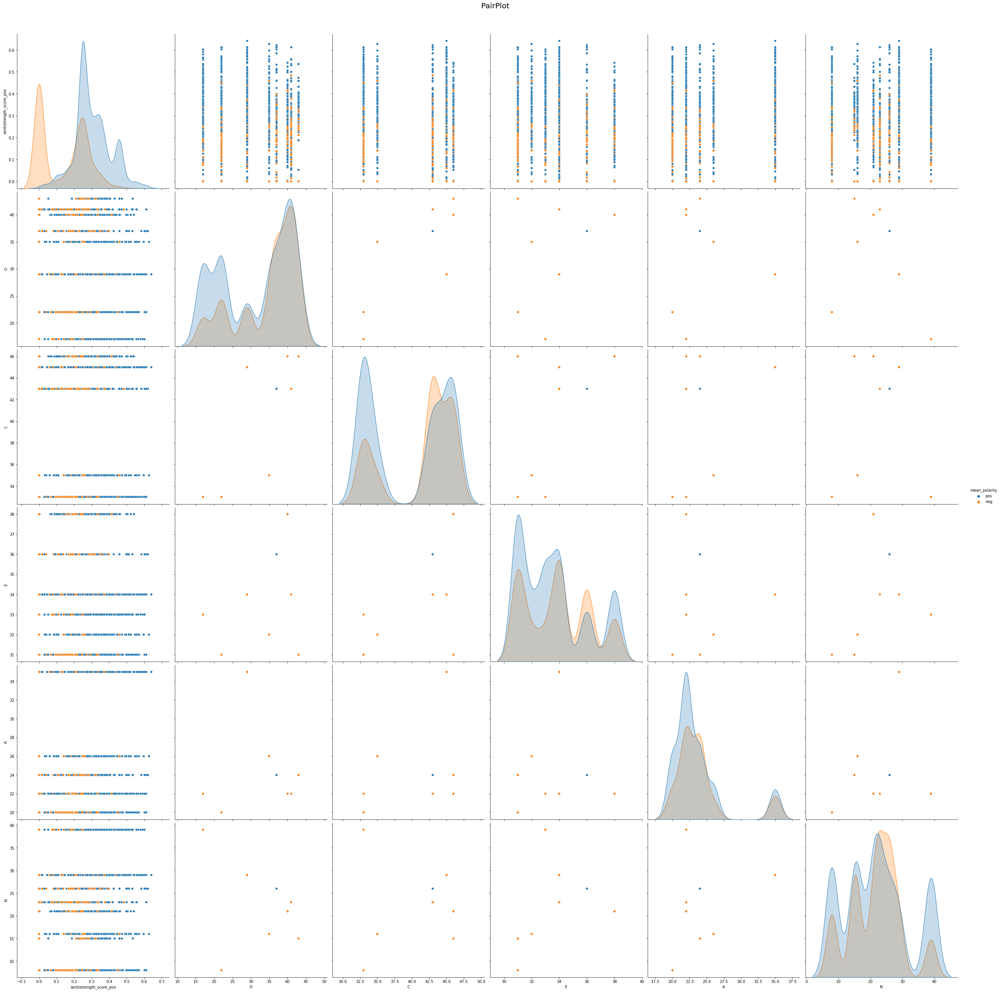

In [30]:
frames = []

count = 1
for c in data:
    id_user = c
    
    df_bf = pd.DataFrame(data[id_user]['bigfive'])
    
    if df_bf.empty == False:
        tweets_pd = create_tweets_pd(data, id_user)
        df = pd.DataFrame(tweets_pd)

        clean_df(df)

        df = df.sort_values(by='created_at')

        df["created_at"] = pd.to_datetime(df["created_at"])
        df['date_minus_time'] = df["created_at"].apply( lambda df : datetime.datetime(year=df.year, month=df.month, day=df.day))
        df.set_index(df["date_minus_time"],inplace=True)

        df_pos = df.query(alg_to_analyze[1] + " == 'pos'")

        df_pos = pd.DataFrame(df_pos[alg_to_analyze[0]].resample('D').mean())

        df_neg = df.query(alg_to_analyze[1] + " == 'neg'")
        df_neg = pd.DataFrame(df_neg[alg_to_analyze[0]].resample('D').mean())

        df_final = pd.merge(df_pos, df_neg, how="outer", on=["date_minus_time"])
        df_final = df_final.fillna(0)
        df_final.columns = ['sentistrength_score_pos', 'sentistrength_score_neg']

        df_final['mean'] = df_final.iloc[:, [0,1]].mean(axis=1)
        df_final.loc[df_final['mean'] > 0, ['mean_polarity']] = 'pos'
        df_final.loc[df_final['mean'] < 0, ['mean_polarity']] = 'neg'

    #     df_final = df_final.drop(df_final["mean_polarity"])
        df_final = df_final.dropna(how = 'any')

        df_final['id_user'] = id_user
        
        df_final['O'] = int(bigfive[id_user]['O'])
        df_final['C'] = int(bigfive[id_user]['C'])
        df_final['E'] = int(bigfive[id_user]['E'])
        df_final['A'] = int(bigfive[id_user]['A'])
        df_final['N'] = int(bigfive[id_user]['N'])

    #     g = sns.pairplot(df_final, diag_kind="kde", height=4)

        count += 1
        
        frames.append(df_final)

#         g = sns.pairplot(df_final, diag_kind="kde", height=6, hue="mean_polarity")
#         g.fig.suptitle("PairPlot - P{} - U{}".format(count, id_user), fontsize=20, y=1.02) # y= some height>1
    #     g.map_lower(sns.kdeplot, levels=4, color=".2")

    #     # Map the plots to the locations
    #     g = g.map_upper(plt.scatter)
    #     g = g.map_upper(corr)
    #     g = g.map_lower(sns.kdeplot)
    #     g = g.map_diag(plt.hist, bins = 10, edgecolor =  'k');

    
result = pd.concat(frames)

# print(result)

# print(result.loc[result['mean_polarity'] == 'neg'])

g = sns.pairplot(result, diag_kind="kde", height=6, hue="mean_polarity", vars=['sentistrength_score_pos', 
                                                                            'O',
                                                                            'C',
                                                                            'E',
                                                                            'A',
                                                                            'N'
                                                                              ])
g.fig.suptitle("PairPlot", fontsize=20, y=1.02) # y= some height>1

In [31]:
ids = result['id_user'].unique()
bf = ['O', 'C', 'E', 'A', 'N']

for b in bf:
    df_chart[b] = 0

for i in ids:
    for b in bf:
        df_chart.loc[df_chart['id_user'] == i, b] = int(bigfive[i][b])
        
        
df_chart.head()

,id_user,pos,neu,neg,por_pos,por_neu,por_neg,mean_all,mean_posneg,O,C,E,A,N
0,26,1008,2754,1277,20.003969,54.653701,25.342330,-0.028798,-0.063507,37,43,36,24,26
1,27,962,2682,905,21.147505,58.958013,19.894482,-0.005644,-0.013751,41,43,34,22,23
2,28,1519,2992,1422,25.602562,50.429799,23.967639,0.001441,0.002907,43,46,31,24,15
3,29,973,1670,706,29.053449,49.865632,21.080920,0.017987,0.035877,0,0,0,0,0
4,30,1517,1219,436,47.824716,38.430013,13.745271,0.114949,0.186696,17,33,33,22,39


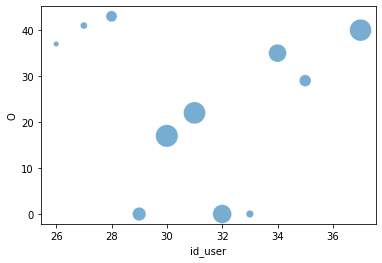

In [32]:

sns.scatterplot(data=df_chart, x="id_user", y="O", 
                size='por_pos', 
                legend=False, 
                sizes=(0, 500),
                cmap="Accent",
                alpha=0.6)


plt.show()

In [33]:
df_chart = df_chart.drop(df_chart[df_chart['O'] == 0].index)
df_chart

,id_user,pos,neu,neg,por_pos,por_neu,por_neg,mean_all,mean_posneg,O,C,E,A,N
0,26,1008,2754,1277,20.003969,54.653701,25.342330,-0.028798,-0.063507,37,43,36,24,26
1,27,962,2682,905,21.147505,58.958013,19.894482,-0.005644,-0.013751,41,43,34,22,23
2,28,1519,2992,1422,25.602562,50.429799,23.967639,0.001441,0.002907,43,46,31,24,15
4,30,1517,1219,436,47.824716,38.430013,13.745271,0.114949,0.186696,17,33,33,22,39
5,31,2805,1986,1205,46.781187,33.122081,20.096731,0.070624,0.105602,22,33,31,20,8
8,34,575,656,314,37.216828,42.459547,20.323625,0.050776,0.088244,35,35,32,26,16
9,35,689,1378,528,26.551060,53.102119,20.346821,0.022095,0.047112,29,45,34,35,29
11,37,2991,2473,992,46.328996,38.305452,15.365551,0.079880,0.129477,40,46,38,22,21


In [34]:
pos_list = df_chart['pos'].tolist()
o_list = df_chart['O'].tolist()
c_list = df_chart['C'].tolist()
e_list = df_chart['E'].tolist()
a_list = df_chart['A'].tolist()
n_list = df_chart['N'].tolist()

print('pos: mean=%.3f stdv=%.3f' % (np.mean(pos_list), np.std(pos_list)))
print('o: mean=%.3f stdv=%.3f' % (np.mean(o_list), np.std(o_list)))
print('c: mean=%.3f stdv=%.3f' % (np.mean(c_list), np.std(c_list)))
print('e: mean=%.3f stdv=%.3f' % (np.mean(e_list), np.std(e_list)))
print('a: mean=%.3f stdv=%.3f' % (np.mean(a_list), np.std(a_list)))
print('n: mean=%.3f stdv=%.3f' % (np.mean(n_list), np.std(n_list)))

r = np.corrcoef(pos_list, o_list)
print('r x o', r)
r = np.corrcoef(pos_list, c_list)
print('r x c', r)
r = np.corrcoef(pos_list, e_list)
print('r x e', r)
r = np.corrcoef(pos_list, a_list)
print('r x a', r)
r = np.corrcoef(pos_list, n_list)
print('r x n', r)

print('pearsonr pos x o: ',scipy.stats.pearsonr(pos_list, o_list))    # Pearson's r
print('pearsonr pos x c: ',scipy.stats.pearsonr(pos_list, c_list))    # Pearson's r
print('pearsonr pos x e: ',scipy.stats.pearsonr(pos_list, e_list))    # Pearson's r
print('pearsonr pos x a: ',scipy.stats.pearsonr(pos_list, a_list))    # Pearson's r
print('pearsonr pos x n: ',scipy.stats.pearsonr(pos_list, n_list))    # Pearson's r
print('spearmanr pos x o: ',scipy.stats.spearmanr(pos_list, o_list))   # Spearman's rho
print('spearmanr pos x c: ',scipy.stats.spearmanr(pos_list, c_list))   # Spearman's rho
print('spearmanr pos x e: ',scipy.stats.spearmanr(pos_list, e_list))   # Spearman's rho
print('spearmanr pos x a: ',scipy.stats.spearmanr(pos_list, a_list))   # Spearman's rho
print('spearmanr pos x n: ',scipy.stats.spearmanr(pos_list, n_list))   # Spearman's rho
print('kendalltau pos x o: ',scipy.stats.kendalltau(pos_list, o_list))  # Kendall's tau
print('kendalltau pos x c: ',scipy.stats.kendalltau(pos_list, c_list))  # Kendall's tau
print('kendalltau pos x e: ',scipy.stats.kendalltau(pos_list, e_list))  # Kendall's tau
print('kendalltau pos x a: ',scipy.stats.kendalltau(pos_list, a_list))  # Kendall's tau
print('kendalltau pos x n: ',scipy.stats.kendalltau(pos_list, n_list))  # Kendall's tau

pos: mean=1508.250 stdv=863.935
o: mean=33.000 stdv=8.846
c: mean=40.500 stdv=5.431
e: mean=33.625 stdv=2.288
a: mean=24.375 stdv=4.357
n: mean=22.125 stdv=8.922
r x o [[ 1.         -0.14521185]
 [-0.14521185  1.        ]]
r x c [[ 1.         -0.07317736]
 [-0.07317736  1.        ]]
r x e [[1.         0.18123204]
 [0.18123204 1.        ]]
r x a [[ 1.         -0.59625837]
 [-0.59625837  1.        ]]
r x n [[ 1.         -0.36074789]
 [-0.36074789  1.        ]]
pearsonr pos x o:  (-0.14521184936357656, 0.7315310785001824)
pearsonr pos x c:  (-0.07317736047395758, 0.8632814864152483)
pearsonr pos x e:  (0.1812320376724083, 0.6675573316283621)
pearsonr pos x a:  (-0.5962583678529723, 0.11873373823493068)
pearsonr pos x n:  (-0.3607478863091596, 0.3799908088417469)
spearmanr pos x o:  SpearmanrResult(correlation=0.09523809523809526, pvalue=0.8225054302036114)
spearmanr pos x c:  SpearmanrResult(correlation=0.181848241863327, pvalue=0.6664768494099012)
spearmanr pos x e:  SpearmanrResult(corr

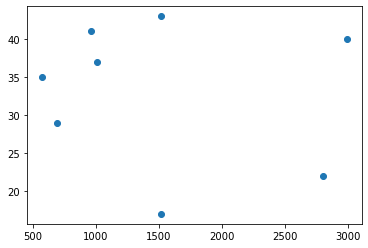

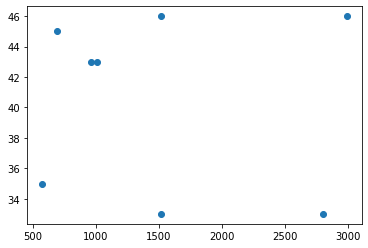

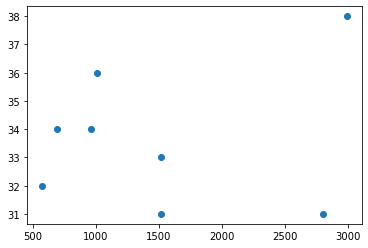

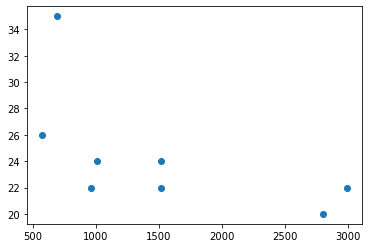

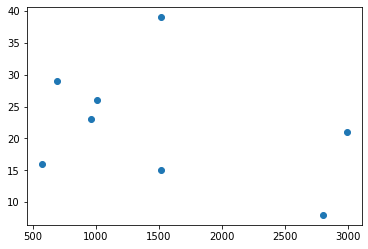

In [35]:
plt.scatter(pos_list, o_list)
plt.show()

plt.scatter(pos_list, c_list)
plt.show()

plt.scatter(pos_list, e_list)
plt.show()

plt.scatter(pos_list, a_list)
plt.show()

plt.scatter(pos_list, n_list)
plt.show()

In [36]:
slope, intercept, r, p, stderr = scipy.stats.linregress(pos_list, o_list)
o_line = f'Regression line: y={intercept:.2f}+{slope:.2f}x, r={r:.2f}'
slope, intercept, r, p, stderr = scipy.stats.linregress(pos_list, c_list)
c_line = f'Regression line: y={intercept:.2f}+{slope:.2f}x, r={r:.2f}'
slope, intercept, r, p, stderr = scipy.stats.linregress(pos_list, e_list)
e_line = f'Regression line: y={intercept:.2f}+{slope:.2f}x, r={r:.2f}'
slope, intercept, r, p, stderr = scipy.stats.linregress(pos_list, a_list)
a_line = f'Regression line: y={intercept:.2f}+{slope:.2f}x, r={r:.2f}'
slope, intercept, r, p, stderr = scipy.stats.linregress(pos_list, n_list)
n_line = f'Regression line: y={intercept:.2f}+{slope:.2f}x, r={r:.2f}'


print('o x pos: ',o_line)
print('c x pos: ',c_line)
print('e x pos: ',e_line)
print('a x pos: ',a_line)
print('n x pos: ',n_line)

o x pos:  Regression line: y=35.24+-0.00x, r=-0.15
c x pos:  Regression line: y=41.19+-0.00x, r=-0.07
e x pos:  Regression line: y=32.90+0.00x, r=0.18
a x pos:  Regression line: y=28.91+-0.00x, r=-0.60
n x pos:  Regression line: y=27.74+-0.00x, r=-0.36


In [37]:
pg.corr(x=df_chart['pos'], y=df_chart['O'])

,n,r,CI95%,r2,adj_r2,p-val,BF10,power
pearson,8,-0.145212,"[-0.77, 0.62]",0.021086,-0.370479,0.731531,0.453,0.062918


In [38]:
pg.pairwise_corr(df_chart).sort_values(by=['p-unc'])[['X', 'Y', 'n', 'r', 'p-unc']].head()

,X,Y,n,r,p-unc
70,mean_all,mean_posneg,8,0.995021,3.075088e-07
46,por_pos,por_neu,8,-0.964462,1.092378e-04
48,por_pos,mean_all,8,0.962501,1.281463e-04
49,por_pos,mean_posneg,8,0.942506,4.548610e-04
25,neu,neg,8,0.901571,2.211509e-03


In [39]:
corr_pos = pg.pairwise_corr(df_chart, columns=[['pos'],['O', 'C', 'E', 'A', 'N']], method='spearman')
corr_pos

,X,Y,method,tail,n,r,CI95%,r2,adj_r2,z,p-unc,power
0,pos,O,spearman,two-sided,8,0.095238,"[-0.65, 0.75]",0.009070,-0.387302,0.095528,0.822505,0.054876
1,pos,C,spearman,two-sided,8,0.181848,"[-0.6, 0.79]",0.033069,-0.353704,0.183893,0.666477,0.071134
2,pos,E,spearman,two-sided,8,0.000000,"[-0.7, 0.7]",0.000000,-0.400000,0.000000,1.000000,0.048936
3,pos,A,spearman,two-sided,8,-0.711991,"[-0.94, -0.01]",0.506932,0.309705,-0.891211,0.047567,0.554658
4,pos,N,spearman,two-sided,8,-0.357143,"[-0.85, 0.46]",0.127551,-0.221429,-0.373607,0.385121,0.142916


In [40]:
corr_neg = pg.pairwise_corr(df_chart, columns=[['neg'],['O', 'C', 'E', 'A', 'N']], method='spearman')
corr_neg

,X,Y,method,tail,n,r,CI95%,r2,adj_r2,z,p-unc,power
0,neg,O,spearman,two-sided,8,0.523810,"[-0.29, 0.9]",0.274376,-0.015873,0.581575,0.182721,0.279659
1,neg,C,spearman,two-sided,8,0.436436,"[-0.39, 0.87]",0.190476,-0.133333,0.467819,0.279658,0.197747
2,neg,E,spearman,two-sided,8,-0.060245,"[-0.73, 0.67]",0.003630,-0.394919,-0.060318,0.887313,0.051300
3,neg,A,spearman,two-sided,8,-0.233239,"[-0.81, 0.56]",0.054400,-0.323840,-0.237612,0.578279,0.086249
4,neg,N,spearman,two-sided,8,-0.428571,"[-0.87, 0.4]",0.183673,-0.142857,-0.458145,0.289403,0.191546


In [41]:
corr_mean_pn = pg.pairwise_corr(df_chart, columns=[['mean_posneg'],['O', 'C', 'E', 'A', 'N']], method='spearman')
corr_mean_pn

,X,Y,method,tail,n,r,CI95%,r2,adj_r2,z,p-unc,power
0,mean_posneg,O,spearman,two-sided,8,-0.595238,"[-0.92, 0.19]",0.354308,0.096032,-0.685740,0.119530,0.366820
1,mean_posneg,C,spearman,two-sided,8,-0.327327,"[-0.84, 0.49]",0.107143,-0.250000,-0.339831,0.428692,0.126347
2,mean_posneg,E,spearman,two-sided,8,-0.132540,"[-0.77, 0.63]",0.017567,-0.375407,-0.133324,0.754383,0.060542
3,mean_posneg,A,spearman,two-sided,8,-0.392823,"[-0.86, 0.43]",0.154310,-0.183966,-0.415134,0.335720,0.165540
4,mean_posneg,N,spearman,two-sided,8,0.023810,"[-0.69, 0.72]",0.000567,-0.399206,0.023814,0.955374,0.049304


In [42]:
corr_mean_all = pg.pairwise_corr(df_chart, columns=[['mean_all'],['O', 'C', 'E', 'A', 'N']], method='spearman')
corr_mean_all

,X,Y,method,tail,n,r,CI95%,r2,adj_r2,z,p-unc,power
0,mean_all,O,spearman,two-sided,8,-0.595238,"[-0.92, 0.19]",0.354308,0.096032,-0.685740,0.119530,0.366820
1,mean_all,C,spearman,two-sided,8,-0.327327,"[-0.84, 0.49]",0.107143,-0.250000,-0.339831,0.428692,0.126347
2,mean_all,E,spearman,two-sided,8,-0.132540,"[-0.77, 0.63]",0.017567,-0.375407,-0.133324,0.754383,0.060542
3,mean_all,A,spearman,two-sided,8,-0.392823,"[-0.86, 0.43]",0.154310,-0.183966,-0.415134,0.335720,0.165540
4,mean_all,N,spearman,two-sided,8,0.023810,"[-0.69, 0.72]",0.000567,-0.399206,0.023814,0.955374,0.049304


In [43]:
df_chart.corr(method='spearman').round(4)

,id_user,pos,neu,neg,por_pos,por_neu,por_neg,mean_all,mean_posneg,O,C,E,A,N
id_user,1.0000,0.1190,-0.5714,-0.4286,0.5952,-0.5952,-0.3571,0.6667,0.6667,-0.2857,0.1818,0.1084,0.1228,-0.0952
pos,0.1190,1.0000,0.4048,0.5952,0.3810,-0.6190,-0.3095,0.4048,0.4048,0.0952,0.1818,0.0000,-0.7120,-0.3571
neu,-0.5714,0.4048,1.0000,0.9048,-0.6667,0.4048,0.4524,-0.6429,-0.6429,0.7619,0.5819,0.1325,-0.1350,-0.2381
neg,-0.4286,0.5952,0.9048,1.0000,-0.4286,0.0714,0.5000,-0.4524,-0.4524,0.5238,0.4364,-0.0602,-0.2332,-0.4286
por_pos,0.5952,0.3810,-0.6667,-0.4286,1.0000,-0.8810,-0.7143,0.9762,0.9762,-0.6905,-0.4728,-0.2892,-0.4419,-0.0476
por_neu,-0.5952,-0.6190,0.4048,0.0714,-0.8810,1.0000,0.4762,-0.8571,-0.8571,0.4762,0.2910,0.3133,0.4910,0.4048
por_neg,-0.3571,-0.3095,0.4524,0.5000,-0.7143,0.4762,1.0000,-0.7619,-0.7619,0.3333,0.3273,-0.1205,0.6261,-0.1905
mean_all,0.6667,0.4048,-0.6429,-0.4524,0.9762,-0.8571,-0.7619,1.0000,1.0000,-0.5952,-0.3273,-0.1325,-0.3928,0.0238
mean_posneg,0.6667,0.4048,-0.6429,-0.4524,0.9762,-0.8571,-0.7619,1.0000,1.0000,-0.5952,-0.3273,-0.1325,-0.3928,0.0238
O,-0.2857,0.0952,0.7619,0.5238,-0.6905,0.4762,0.3333,-0.5952,-0.5952,1.0000,0.7638,0.1687,0.1350,-0.3333


In [44]:
pg.corr(df_chart['pos'], df_chart['A']).round(4)

,n,r,CI95%,r2,adj_r2,p-val,BF10,power
pearson,8,-0.5963,"[-0.92, 0.19]",0.3555,0.0977,0.1187,1.238,0.3682


Text(0.5, 1.0, 'Correlation matrix')

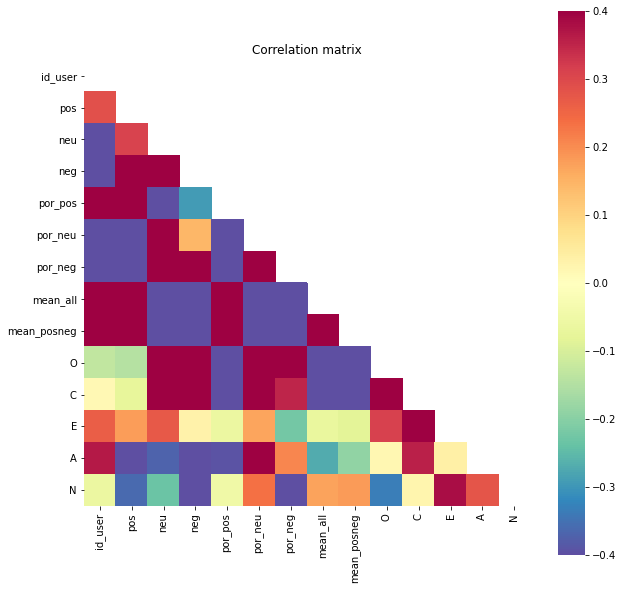

In [45]:
fig, ax = plt.subplots(figsize=(10,10))         # Sample figsize in inches

corrs = df_chart.corr()
mask = np.zeros_like(corrs)
mask[np.triu_indices_from(mask)] = True
sns.heatmap(corrs, cmap='Spectral_r', mask=mask, square=True, vmin=-.4, vmax=.4)
plt.title('Correlation matrix')

In [46]:
df_chart.rcorr(method='spearman', upper='pval', decimals=3, padjust=None, stars=False)

,id_user,pos,neu,neg,por_pos,por_neu,por_neg,mean_all,mean_posneg,O,C,E,A,N
id_user,-,0.779,0.139,0.289,0.12,0.12,0.385,0.071,0.071,0.493,0.666,0.798,0.772,0.823
pos,0.119,-,0.32,0.12,0.352,0.102,0.456,0.32,0.32,0.823,0.666,1.,0.048,0.385
neu,-0.571,0.405,-,0.002,0.071,0.32,0.260,0.086,0.086,0.028,0.130,0.754,0.75,0.570
neg,-0.429,0.595,0.905,-,0.289,0.867,0.207,0.260,0.260,0.183,0.28,0.887,0.578,0.289
por_pos,0.595,0.381,-0.667,-0.429,-,0.004,0.047,0.000,0.000,0.058,0.237,0.487,0.273,0.911
por_neu,-0.595,-0.619,0.405,0.071,-0.881,-,0.233,0.007,0.007,0.233,0.484,0.45,0.217,0.32
por_neg,-0.357,-0.31,0.452,0.5,-0.714,0.476,-,0.028,0.028,0.42,0.429,0.776,0.097,0.651
mean_all,0.667,0.405,-0.643,-0.452,0.976,-0.857,-0.762,-,0.,0.12,0.429,0.754,0.336,0.955
mean_posneg,0.667,0.405,-0.643,-0.452,0.976,-0.857,-0.762,1.0,-,0.12,0.429,0.754,0.336,0.955
O,-0.286,0.095,0.762,0.524,-0.69,0.476,0.333,-0.595,-0.595,-,0.027,0.69,0.75,0.42


In [47]:
pg.homoscedasticity(df_chart)

,W,pval,equal_var
levene,0.445112,0.871454,True


In [48]:
pg.normality(df_chart)

,W,pval,normal
id_user,0.945988,0.670778,True
pos,0.853433,0.103189,True
neu,0.920830,0.436632,True
neg,0.927336,0.492149,True
por_pos,0.847784,0.090462,True
por_neu,0.934225,0.555298,True
por_neg,0.920042,0.430205,True
mean_all,0.968228,0.883748,True
mean_posneg,0.983579,0.978407,True
O,0.903375,0.309755,True


In [49]:
df_chart

,id_user,pos,neu,neg,por_pos,por_neu,por_neg,mean_all,mean_posneg,O,C,E,A,N
0,26,1008,2754,1277,20.003969,54.653701,25.342330,-0.028798,-0.063507,37,43,36,24,26
1,27,962,2682,905,21.147505,58.958013,19.894482,-0.005644,-0.013751,41,43,34,22,23
2,28,1519,2992,1422,25.602562,50.429799,23.967639,0.001441,0.002907,43,46,31,24,15
4,30,1517,1219,436,47.824716,38.430013,13.745271,0.114949,0.186696,17,33,33,22,39
5,31,2805,1986,1205,46.781187,33.122081,20.096731,0.070624,0.105602,22,33,31,20,8
8,34,575,656,314,37.216828,42.459547,20.323625,0.050776,0.088244,35,35,32,26,16
9,35,689,1378,528,26.551060,53.102119,20.346821,0.022095,0.047112,29,45,34,35,29
11,37,2991,2473,992,46.328996,38.305452,15.365551,0.079880,0.129477,40,46,38,22,21


In [50]:
print(pg.mwu(df_chart['pos'], df_chart['O']))
print(pg.mwu(df_chart['neg'], df_chart['O']))

     U-val       tail     p-val  RBC  CLES
MWU   64.0  two-sided  0.000939 -1.0   1.0
     U-val       tail     p-val  RBC  CLES
MWU   64.0  two-sided  0.000939 -1.0   1.0


In [51]:
print(pg.mwu(df_chart['pos'], df_chart['C']))
print(pg.mwu(df_chart['neg'], df_chart['C']))

     U-val       tail     p-val  RBC  CLES
MWU   64.0  two-sided  0.000915 -1.0   1.0
     U-val       tail     p-val  RBC  CLES
MWU   64.0  two-sided  0.000915 -1.0   1.0


In [52]:
print(pg.mwu(df_chart['pos'], df_chart['E']))
print(pg.mwu(df_chart['neg'], df_chart['E']))

     U-val       tail     p-val  RBC  CLES
MWU   64.0  two-sided  0.000923 -1.0   1.0
     U-val       tail     p-val  RBC  CLES
MWU   64.0  two-sided  0.000923 -1.0   1.0


In [53]:
print(pg.mwu(df_chart['pos'], df_chart['A']))
print(pg.mwu(df_chart['neg'], df_chart['A']))

     U-val       tail     p-val  RBC  CLES
MWU   64.0  two-sided  0.000899 -1.0   1.0
     U-val       tail     p-val  RBC  CLES
MWU   64.0  two-sided  0.000899 -1.0   1.0


In [54]:
print(pg.mwu(df_chart['pos'], df_chart['N']))
print(pg.mwu(df_chart['neg'], df_chart['N']))

     U-val       tail     p-val  RBC  CLES
MWU   64.0  two-sided  0.000939 -1.0   1.0
     U-val       tail     p-val  RBC  CLES
MWU   64.0  two-sided  0.000939 -1.0   1.0


In [55]:
print(pg.kruskal(data=df_chart, dv='pos', between='O'))
print(pg.kruskal(data=df_chart, dv='neg', between='O'))

        Source  ddof1    H    p-unc
Kruskal      O      7  7.0  0.42888
        Source  ddof1    H    p-unc
Kruskal      O      7  7.0  0.42888


In [56]:
print(pg.kruskal(data=df_chart, dv='pos', between='C'))
print(pg.kruskal(data=df_chart, dv='neg', between='C'))

        Source  ddof1     H    p-unc
Kruskal      C      4  6.25  0.18124
        Source  ddof1         H    p-unc
Kruskal      C      4  4.166667  0.38392


In [57]:
print(pg.kruskal(data=df_chart, dv='pos', between='E'))
print(pg.kruskal(data=df_chart, dv='neg', between='E'))

        Source  ddof1         H     p-unc
Kruskal      E      5  6.833333  0.233334
        Source  ddof1         H     p-unc
Kruskal      E      5  6.583333  0.253517


In [58]:
print(pg.kruskal(data=df_chart, dv='pos', between='A'))
print(pg.kruskal(data=df_chart, dv='neg', between='A'))

        Source  ddof1         H     p-unc
Kruskal      A      4  4.555556  0.336011
        Source  ddof1         H     p-unc
Kruskal      A      4  6.138889  0.189013


In [59]:
print(pg.kruskal(data=df_chart, dv='pos', between='N'))
print(pg.kruskal(data=df_chart, dv='neg', between='N'))

        Source  ddof1    H    p-unc
Kruskal      N      7  7.0  0.42888
        Source  ddof1    H    p-unc
Kruskal      N      7  7.0  0.42888
